In [8]:
# Packages necessary for this notebook
import numpy             as np
import pandas            as pd
import xarray            as xr
import seaborn           as sns
import cartopy.crs       as crs
import cartopy.feature   as cfeature
import matplotlib
import matplotlib.pyplot as plt
from scipy import stats

In [9]:
# Import the NOAA data from 1981-2019
NOAA = xr.open_dataset(r'D:\CRI_Modelling_PC\Netcdf Data\NOAA\sst.day.mean.PacCst.1981-2019.nc')

In [10]:
# Put in your temperature ranges here:
# All temperatures in Celcius
min_Temp = 5
max_Temp = 17.6

In [11]:
# Get lat and lon data
lat = NOAA.lat.data
lon = NOAA.lon.data

In [12]:
NOAA_years = np.where((pd.DatetimeIndex(NOAA.time.data).year>=1982) & (pd.DatetimeIndex(NOAA.time.data).year<=2018))
NOAA_short = NOAA.sst[(NOAA_years[0]),:,:]

In [13]:
# Create a mask for land, count the days, and average them over years
NOAA_Mask  = NOAA.sst.where(NOAA.sst.isnull(), 1)
NOAA_Count = NOAA_short.where((NOAA_short <= max_Temp) & (NOAA_short >= min_Temp)).groupby('time.year').count(dim='time')
count_Mean = NOAA_Count.mean(dim="year")
NOAA_Final = count_Mean*NOAA_Mask[0,:,:]

In [14]:
# Standard deviation data. We might change this, but for now this works
std_Dev = NOAA_Count.std(dim="year")*NOAA_Mask[0,:,:]

In [15]:
# Just for getting state lines 
states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='50m',
        facecolor='none')

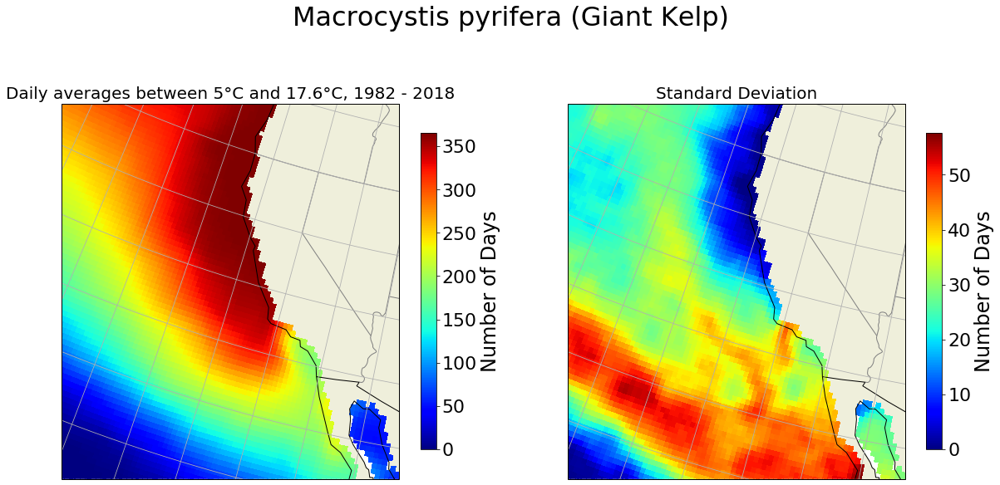

In [17]:
# Creating a figure, change name to species name
fig = plt.figure(figsize=[20,10])
fig.suptitle('Macrocystis pyrifera (Giant Kelp)',fontsize=32)

# Plot the count_Mean data
NOAA_Plot = fig.add_subplot(1,2,1,projection=crs.LambertConformal())
NOAA_Plot.set_title('Daily averages between ' + str(min_Temp) + '\u00b0C and ' + str(max_Temp) + '\u00b0C, 1982 - 2018', fontsize=20)
NOAA_Plot.set_extent([230,245,28,43], crs.Geodetic())
NOAA_Colormesh = NOAA_Plot.pcolormesh(lon, lat, NOAA_Final.data,
             transform=crs.PlateCarree(),
             cmap='jet',vmax=365)
NOAA_Plot.add_feature(cfeature.COASTLINE)
NOAA_Plot.add_feature(cfeature.LAND)
NOAA_Plot.add_feature(cfeature.BORDERS)
NOAA_Plot.add_feature(states_provinces, edgecolor='gray')
NOAA_Plot.gridlines()

# Create a colorbar
colorbar = fig.colorbar(NOAA_Colormesh, shrink=0.7, anchor=('SW'))
colorbar.set_label('Number of Days',fontsize=24)
colorbar.ax.tick_params(labelsize=22)

# Plot the std_Dev data
std_Plot = fig.add_subplot(1,2,2,projection=crs.LambertConformal())
std_Plot.set_title('Standard Deviation', fontsize=20)
std_Plot.set_extent([230,245,28,43], crs.Geodetic())
std_Colormesh = std_Plot.pcolormesh(lon, lat, std_Dev.data,
             transform=crs.PlateCarree(),
             cmap='jet')
std_Plot.add_feature(cfeature.COASTLINE)
std_Plot.add_feature(cfeature.LAND)
std_Plot.add_feature(cfeature.BORDERS)
std_Plot.add_feature(states_provinces, edgecolor='gray')
std_Plot.gridlines()

# A new colorbar
colorbar2 = fig.colorbar(std_Colormesh, shrink=0.7, anchor=('SW'))
colorbar2.set_label('Number of Days',fontsize=24)
colorbar2.ax.tick_params(labelsize=22)

fig.savefig(r"D:\CRI_Modelling_PC\CRI Maps\Giant_Kelp_Days.jpeg", bbox_inches='tight')

C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


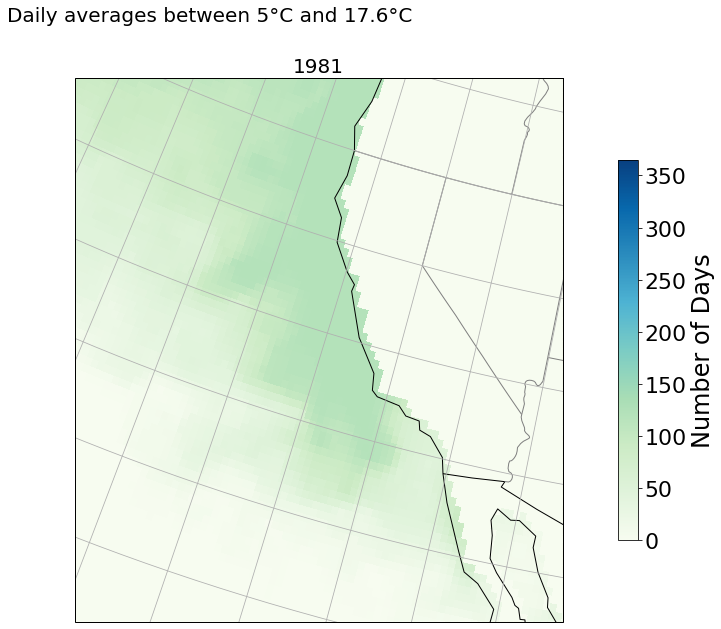

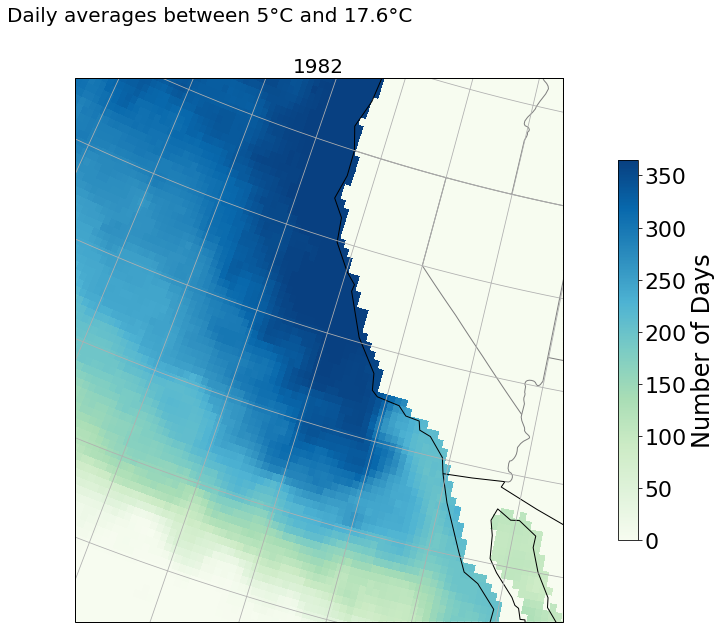

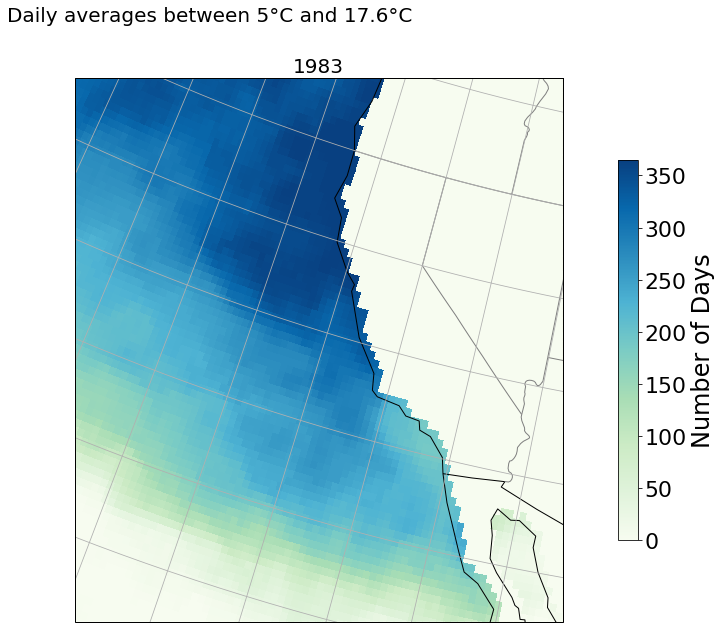

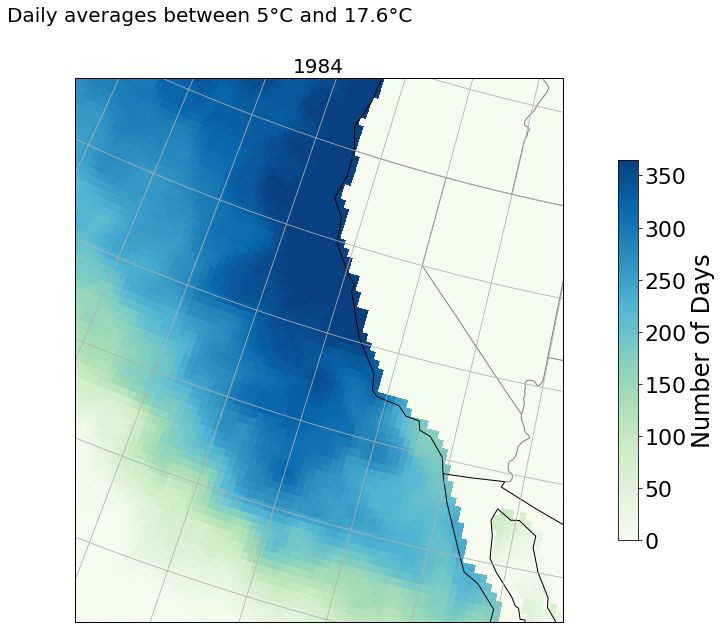

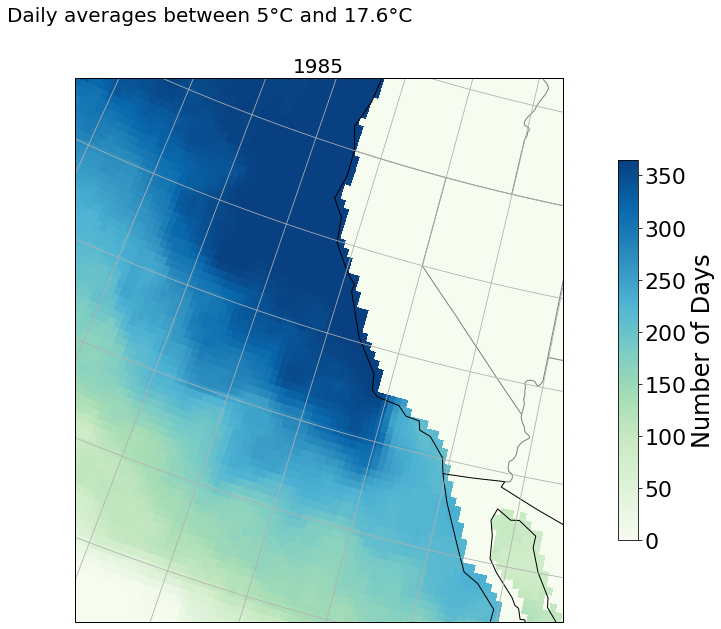

...

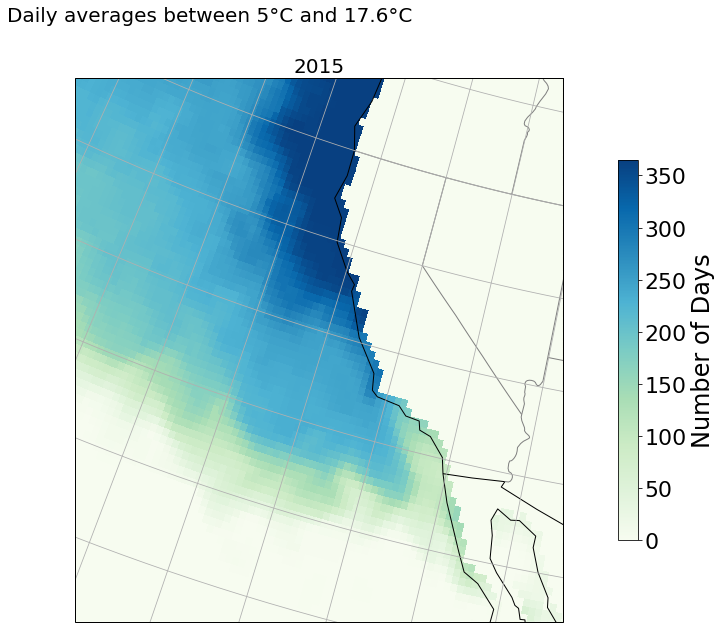

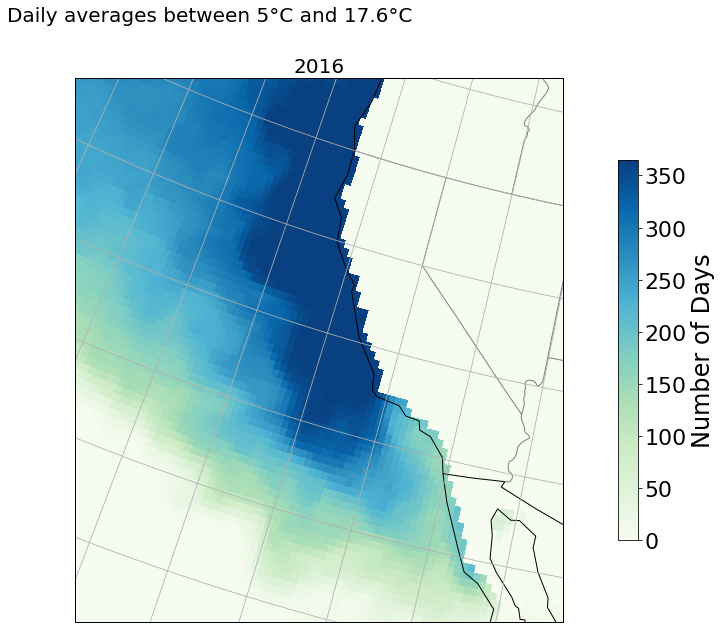

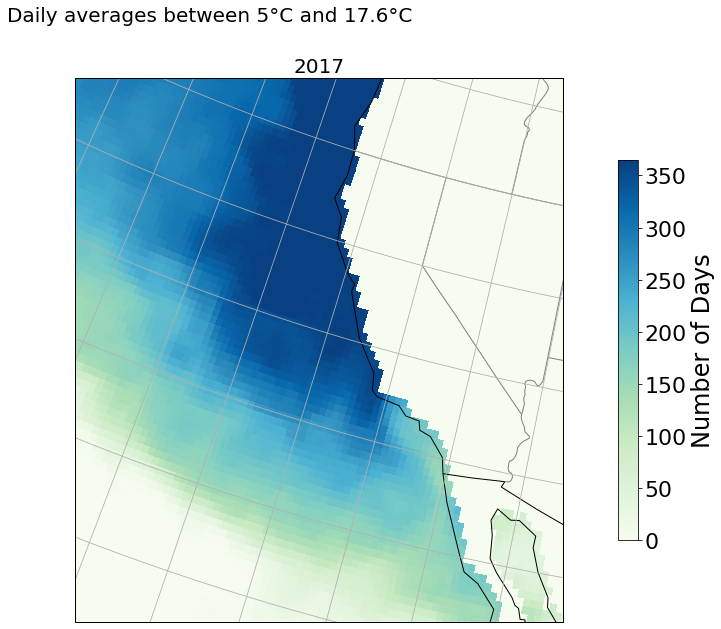

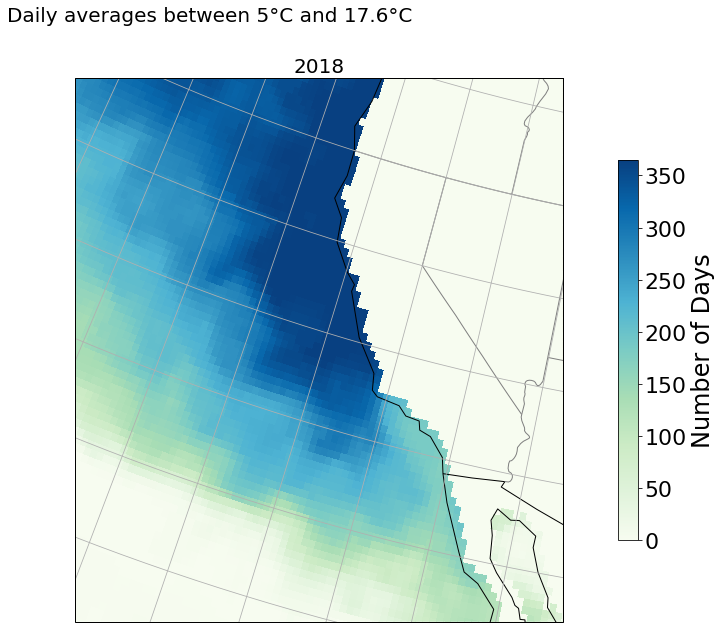

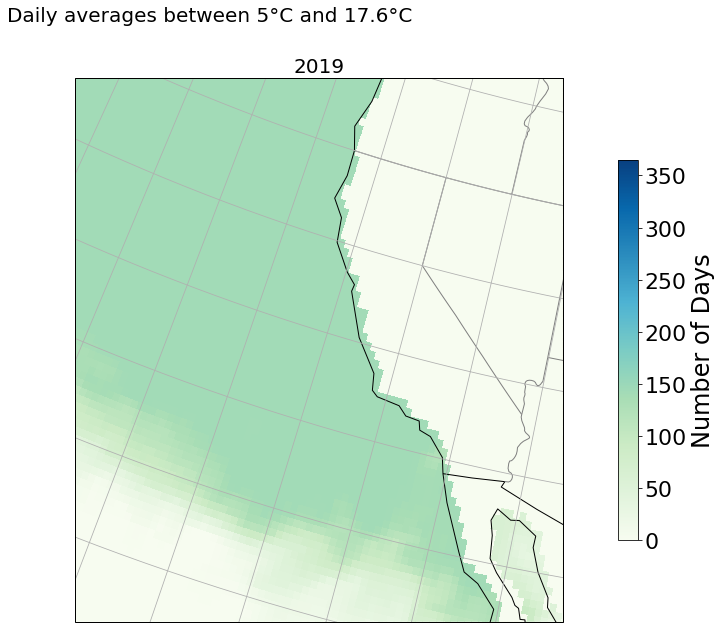

In [10]:
for ii in NOAA_Count.sst:
    #print(ii*NOAA_Mask[0,:,:])
    fig = plt.figure(figsize=[20,10])
    fig.suptitle('Daily averages between ' + str(min_Temp) + '\u00b0C and ' + str(max_Temp) + '\u00b0C',fontsize=20)

    # Plot the count_Mean data
    NOAA_Plot = fig.add_subplot(1,1,1,projection=crs.LambertConformal())
    NOAA_Plot.set_title(ii.year.data, fontsize=20)
    NOAA_Plot.set_extent([230,245,28,43], crs.Geodetic())
    NOAA_Colormesh = NOAA_Plot.pcolormesh(lon, lat, ii.data,
                 transform=crs.PlateCarree(),
                 cmap='GnBu',vmax=365,vmin=0)
    NOAA_Plot.add_feature(cfeature.COASTLINE)
    NOAA_Plot.add_feature(cfeature.LAND)
    NOAA_Plot.add_feature(cfeature.BORDERS)
    NOAA_Plot.add_feature(states_provinces, edgecolor='gray')
    NOAA_Plot.gridlines()

    # Create a colorbar
    colorbar = fig.colorbar(NOAA_Colormesh, shrink=0.7, anchor=('SW'))
    colorbar.set_label('Number of Days',fontsize=24)
    colorbar.ax.tick_params(labelsize=22)
    
    fig.savefig(r"D:\CRI_Modelling_PC\CRI Maps\Kelp gif\ "+str(ii.year.data)+".tif", bbox_inches='tight')

In [10]:
for ii in NOAA.sst:
    for jj in ii:
        print(jj)

<xarray.DataArray 'sst' (lon: 240)>
array([28.09    , 28.109999, 28.13    , ..., 28.359999, 28.18    , 27.89    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.125
    time     datetime64[ns] 1981-09-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.939999, 27.93    , 27.939999, ..., 28.359999, 28.3     , 28.109999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.375
    time     datetime64[ns] 1981-09-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:    

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.769999, 24.769999, 24.73    , ...,       nan,       nan, 28.22    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.375
    time     datetime64[ns] 1981-09-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.539999, 24.56    , 24.519999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.625
    time     datetime64[ns] 1981-09-01
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.73    , 12.639999, 12.54    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.625
    time     datetime64[ns] 1981-09-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.55, 12.53, 12.45, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.875
    time     datetime64[ns] 1981-09-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.33, 25.23, 25.22, ..., 28.05,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.625
    time     datetime64[ns] 1981-09-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.24    , 25.14    , 25.13    , ..., 27.439999, 26.72    ,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.875
    time     datetime64[ns] 1981-09-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.39, 18.38, 18.47, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.625
    time     datetime64[ns] 1981-09-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.07, 18.07, 18.13, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.875
    time     datetime64[ns] 1981-09-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.67    , 27.64    , 27.68    , ..., 27.869999, 27.96    , 28.06    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.875
    time     datetime64[ns] 1981-09-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.47    , 27.439999, 27.43    , ..., 28.07    , 28.26    , 28.47    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.125
    time     datetime64[ns] 1981-09-03
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.26, 24.21, 24.15, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.375
    time     datetime64[ns] 1981-09-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.269999, 24.25    , 24.21    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.625
    time     datetime64[ns] 1981-09-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.38, 12.34, 12.21, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 51.125
    time     datetime64[ns] 1981-09-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.17    , 12.11    , 12.099999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 51.375
    time     datetime64[ns] 1981-09-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.16    , 25.15    , 25.25    , ..., 27.68    , 27.21    , 27.119999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 21.375
    time     datetime64[ns] 1981-09-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.26    , 25.23    , 25.269999, ..., 28.289999, 28.189999, 28.24    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 21.625
    time     datetime64[ns] 1981-09-04
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.6     , 18.699999, 18.82    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.625
    time     datetime64[ns] 1981-09-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.42, 18.58, 18.77, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.875
    time     datetime64[ns] 1981-09-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.48, 27.4 , 27.24, ..., 27.55, 27.56, 27.51], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.625
    time     datetime64[ns] 1981-09-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.38    , 27.289999, 27.189999, ..., 27.689999, 27.599998, 27.55    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.875
    time     datetime64[ns] 1981-09-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.289999, 24.21    , 24.21    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.125
    time     datetime64[ns] 1981-09-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.41, 24.31, 24.26, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.375
    time     datetime64[ns] 1981-09-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.429999, 12.54    , 12.599999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.375
    time     datetime64[ns] 1981-09-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.389999, 12.38    , 12.44    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.625
    time     datetime64[ns] 1981-09-05
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.699999, 25.57    , 25.43    , ..., 30.32    , 30.439999, 30.49    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.625
    time     datetime64[ns] 1981-09-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.64    , 25.51    , 25.42    , ..., 30.42    , 30.619999, 30.679998],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.875
    time     datetime64[ns] 1981-09-06
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.47, 17.83, 18.21, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.875
    time     datetime64[ns] 1981-09-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.      , 17.3     , 17.609999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.125
    time     datetime64[ns] 1981-09-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.84    , 26.859999, 26.779999, ..., 28.67    , 28.64    , 28.56    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.625
    time     datetime64[ns] 1981-09-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.81    , 26.89    , 26.92    , ..., 28.75    , 28.56    , 28.539999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.875
    time     datetime64[ns] 1981-09-07
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.42, 24.42, 24.48, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.125
    time     datetime64[ns] 1981-09-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.43    , 24.359999, 24.359999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.375
    time     datetime64[ns] 1981-09-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.25    , 12.27    , 12.219999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.125
    time     datetime64[ns] 1981-09-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.24, 12.3 , 12.28, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.375
    time     datetime64[ns] 1981-09-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.31    , 25.199999, 25.07    , ..., 29.9     , 30.07    , 30.14    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.125
    time     datetime64[ns] 1981-09-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.4     , 25.289999, 25.119999, ..., 29.73    , 29.9     , 30.08    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.375
    time     datetime64[ns] 1981-09-08
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.25, 16.46, 16.75, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.125
    time     datetime64[ns] 1981-09-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.98, 16.17, 16.42, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.375
    time     datetime64[ns] 1981-09-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.09    , 27.039999, 27.      , ..., 29.019999, 28.859999, 28.849998],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.375
    time     datetime64[ns] 1981-09-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.119999, 27.109999, 27.039999, ..., 28.73    , 28.55    , 28.51    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.625
    time     datetime64[ns] 1981-09-09
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.      , 23.88    , 23.769999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.625
    time     datetime64[ns] 1981-09-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.8 , 23.63, 23.46, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.875
    time     datetime64[ns] 1981-09-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.509999, 12.52    , 12.53    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.875
    time     datetime64[ns] 1981-09-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.59    , 12.599999, 12.61    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.125
    time     datetime64[ns] 1981-09-09
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.42    , 25.4     , 25.39    , ..., 30.07    , 30.109999, 30.189999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.875
    time     datetime64[ns] 1981-09-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.449999, 25.41    , 25.39    , ..., 30.189999, 30.15    , 30.119999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.125
    time     datetime64[ns] 1981-09-10
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.429999, 15.5     , 15.639999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.125
    time     datetime64[ns] 1981-09-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.179999, 15.299999, 15.42    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.375
    time     datetime64[ns] 1981-09-10
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.33, 27.21, 27.08, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.375
    time     datetime64[ns] 1981-09-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.15    , 27.019999, 26.96    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.625
    time     datetime64[ns] 1981-09-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.369999, 24.35    , 24.289999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.875
    time     datetime64[ns] 1981-09-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.31, 24.23, 24.13, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.125
    time     datetime64[ns] 1981-09-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.889999, 11.96    , 12.059999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.875
    time     datetime64[ns] 1981-09-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.79    , 11.91    , 12.059999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.125
    time     datetime64[ns] 1981-09-11
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.93    , 25.859999, 25.769999, ..., 30.039999, 30.      , 29.8     ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.125
    time     datetime64[ns] 1981-09-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.97    , 25.92    , 25.82    , ..., 29.939999, 29.88    , 29.72    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.375
    time     datetime64[ns] 1981-09-12
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.13, 14.15, 14.17, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.375
    time     datetime64[ns] 1981-09-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.12    , 14.17    , 14.099999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.625
    time     datetime64[ns] 1981-09-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.99, 27.06, 27.23, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 15.625
    time     datetime64[ns] 1981-09-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.859999, 26.97    , 27.109999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 15.875
    time     datetime64[ns] 1981-09-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.07, 23.07, 23.07, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.125
    time     datetime64[ns] 1981-09-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.029999, 23.05    , 22.98    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.375
    time     datetime64[ns] 1981-09-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.25    , 12.13    , 11.969999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.125
    time     datetime64[ns] 1981-09-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.37, 12.24, 12.12, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.375
    time     datetime64[ns] 1981-09-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.84    , 25.76    , 25.699999, ..., 30.06    , 29.96    , 29.859999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.125
    time     datetime64[ns] 1981-09-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.93    , 25.849998, 25.769999, ..., 29.96    , 29.939999, 29.96    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.375
    time     datetime64[ns] 1981-09-14
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.08, 13.15, 13.17, ..., 16.6 , 16.65, 16.59], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.625
    time     datetime64[ns] 1981-09-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.809999, 12.92    , 12.99    , ..., 16.369999, 16.42    , 16.34    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.875
    time     datetime64[ns] 1981-09-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.16, 26.33, 26.56, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.875
    time     datetime64[ns] 1981-09-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.109999, 26.16    , 26.199999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.125
    time     datetime64[ns] 1981-09-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.359999, 21.619999, 21.76    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.125
    time     datetime64[ns] 1981-09-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.07, 21.35, 21.56, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.375
    time     datetime64[ns] 1981-09-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.77, 12.04, 12.23, ...,   nan,  3.79,  3.81], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.125
    time     datetime64[ns] 1981-09-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.17, 11.54, 11.82, ...,  4.28,  4.2 ,  4.24], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.375
    time     datetime64[ns] 1981-09-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.08    , 26.109999, 25.91    , ..., 29.92    , 29.76    , 29.72    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.625
    time     datetime64[ns] 1981-09-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.      , 25.98    , 25.74    , ..., 29.82    , 29.67    , 29.599998],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.875
    time     datetime64[ns] 1981-09-16
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.4 , 12.54, 12.7 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.875
    time     datetime64[ns] 1981-09-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.37    , 12.509999, 12.639999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.125
    time     datetime64[ns] 1981-09-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.31, 26.25, 26.16, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.875
    time     datetime64[ns] 1981-09-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.3     , 26.25    , 26.109999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.125
    time     datetime64[ns] 1981-09-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.05    , 21.039999, 21.13    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.125
    time     datetime64[ns] 1981-09-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.88, 20.93, 21.02, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.375
    time     datetime64[ns] 1981-09-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 9.78    , 10.05    , 10.469999, ...,  5.41    ,  5.4     ,  5.39    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.125
    time     datetime64[ns] 1981-09-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.179999, 10.34    , 10.65    , ...,  5.45    ,  5.51    ,  5.52    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.375
    time     datetime64[ns] 1981-09-17
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.439999, 25.22    , 25.      , ..., 28.289999, 28.38    , 29.01    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.375
    time     datetime64[ns] 1981-09-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.41    , 25.17    , 24.939999, ..., 27.849998, 28.06    , 28.88    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.625
    time     datetime64[ns] 1981-09-18
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.92, 11.91, 11.9 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.625
    time     datetime64[ns] 1981-09-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.92    , 11.88    , 11.889999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.875
    time     datetime64[ns] 1981-09-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.279999, 26.22    , 26.18    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.625
    time     datetime64[ns] 1981-09-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.09, 26.01, 25.99, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.875
    time     datetime64[ns] 1981-09-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.18, 19.33, 19.48, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.125
    time     datetime64[ns] 1981-09-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.789999, 18.9     , 19.02    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.375
    time     datetime64[ns] 1981-09-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.49    , 11.429999, 11.41    , ...,  5.49    ,  5.61    ,  5.58    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.125
    time     datetime64[ns] 1981-09-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.42, 11.36, 11.4 , ...,  5.8 ,  5.77,  5.62], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.375
    time     datetime64[ns] 1981-09-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.43    , 25.25    , 25.109999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.375
    time     datetime64[ns] 1981-09-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.39, 25.25, 25.16, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.625
    time     datetime64[ns] 1981-09-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.929999, 11.96    , 11.969999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.125
    time     datetime64[ns] 1981-09-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.9     , 11.929999, 11.91    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.375
    time     datetime64[ns] 1981-09-20
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.74, 25.74, 25.74, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.625
    time     datetime64[ns] 1981-09-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.74    , 25.74    , 25.76    , ..., 29.789999,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.875
    time     datetime64[ns] 1981-09-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.41    , 18.35    , 18.279999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.125
    time     datetime64[ns] 1981-09-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.98    , 18.119999, 18.23    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.375
    time     datetime64[ns] 1981-09-21
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([28.38    , 28.279999, 28.17    , ..., 28.23    , 28.269999, 28.32    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.125
    time     datetime64[ns] 1981-09-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([28.369999, 28.25    , 28.109999, ..., 28.31    , 28.31    , 28.34    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.375
    time     datetime64[ns] 1981-09-22
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.75    , 24.65    , 24.689999, ...,       nan,       nan, 24.57    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.375
    time     datetime64[ns] 1981-09-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.43    , 24.359999, 24.46    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.625
    time     datetime64[ns] 1981-09-22
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.66, 11.67, 11.65, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.625
    time     datetime64[ns] 1981-09-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.509999, 11.5     , 11.48    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.875
    time     datetime64[ns] 1981-09-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.029999, 26.01    , 25.949999, ..., 28.789999,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.625
    time     datetime64[ns] 1981-09-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.05    , 26.039999, 26.      , ..., 28.59    , 28.14    ,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.875
    time     datetime64[ns] 1981-09-23
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.25    , 17.359999, 17.38    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.625
    time     datetime64[ns] 1981-09-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.25    , 17.359999, 17.35    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.875
    time     datetime64[ns] 1981-09-23
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([28.109999, 28.07    , 28.029999, ..., 28.67    , 28.47    , 28.289999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.875
    time     datetime64[ns] 1981-09-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([28.22    , 28.17    , 28.109999, ..., 28.82    , 28.599998, 28.39    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.125
    time     datetime64[ns] 1981-09-24
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.5 , 24.47, 24.57, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.875
    time     datetime64[ns] 1981-09-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.55, 24.57, 24.65, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.125
    time     datetime64[ns] 1981-09-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.469999, 11.62    , 11.69    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.625
    time     datetime64[ns] 1981-09-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.3     , 11.429999, 11.53    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.875
    time     datetime64[ns] 1981-09-24
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.449999, 25.25    , 25.019999, ..., 28.859999, 28.529999, 28.349998],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 21.125
    time     datetime64[ns] 1981-09-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.529999, 25.32    , 25.08    , ..., 29.15    , 28.91    , 28.769999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 21.375
    time     datetime64[ns] 1981-09-25
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.449999, 16.5     , 16.47    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.625
    time     datetime64[ns] 1981-09-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.22, 16.35, 16.47, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.875
    time     datetime64[ns] 1981-09-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.57    , 27.38    , 27.109999, ..., 29.539999, 29.5     , 29.519999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.625
    time     datetime64[ns] 1981-09-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.529999, 27.369999, 27.15    , ..., 29.76    , 29.869999, 30.019999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.875
    time     datetime64[ns] 1981-09-26
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.49    , 24.539999, 24.56    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.625
    time     datetime64[ns] 1981-09-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.519999, 24.55    , 24.529999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.875
    time     datetime64[ns] 1981-09-26
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.41    , 11.469999, 11.49    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 51.875
    time     datetime64[ns] 1981-09-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.24    , 11.28    , 11.309999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.125
    time     datetime64[ns] 1981-09-26
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.46    , 25.39    , 25.279999, ..., 29.66    , 29.81    , 29.859999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.125
    time     datetime64[ns] 1981-09-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.279999, 25.25    , 25.199999, ..., 29.859999, 30.019999, 30.039999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.375
    time     datetime64[ns] 1981-09-27
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.139999, 15.19    , 15.309999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.375
    time     datetime64[ns] 1981-09-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.049999, 15.139999, 15.23    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.625
    time     datetime64[ns] 1981-09-27
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.71    , 27.64    , 27.609999, ..., 29.38    , 29.21    , 29.119999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.125
    time     datetime64[ns] 1981-09-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.539999, 27.59    , 27.66    , ..., 29.529999, 29.449999, 29.369999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.375
    time     datetime64[ns] 1981-09-28
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.84, 23.88, 23.92, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.625
    time     datetime64[ns] 1981-09-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.8     , 23.81    , 23.859999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.875
    time     datetime64[ns] 1981-09-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.98, 10.98, 10.99, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.375
    time     datetime64[ns] 1981-09-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.76    , 10.809999, 10.84    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.625
    time     datetime64[ns] 1981-09-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.939999, 24.9     , 24.869999, ..., 30.05    , 30.13    , 30.08    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.375
    time     datetime64[ns] 1981-09-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.85    , 24.81    , 24.789999, ..., 30.14    , 30.17    , 30.099998],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.625
    time     datetime64[ns] 1981-09-29
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.69, 15.79, 15.9 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.375
    time     datetime64[ns] 1981-09-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.559999, 15.63    , 15.7     , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.625
    time     datetime64[ns] 1981-09-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([28.029999, 28.109999, 28.07    , ..., 29.199999, 29.179998, 29.14    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.625
    time     datetime64[ns] 1981-09-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.73    , 27.83    , 27.82    , ..., 29.439999, 29.449999, 29.49    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.875
    time     datetime64[ns] 1981-09-30
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.64, 23.72, 23.81, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.875
    time     datetime64[ns] 1981-09-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.5 , 23.55, 23.64, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.125
    time     datetime64[ns] 1981-09-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.28, 10.41, 10.61, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.875
    time     datetime64[ns] 1981-09-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.389999, 10.51    , 10.69    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.125
    time     datetime64[ns] 1981-09-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.22    , 25.279999, 25.31    , ..., 29.08    , 29.109999, 29.06    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.625
    time     datetime64[ns] 1981-10-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.22    , 25.289999, 25.33    , ..., 29.21    , 29.099998, 29.109999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.875
    time     datetime64[ns] 1981-10-01
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.66, 14.79, 14.88, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.125
    time     datetime64[ns] 1981-10-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.309999, 14.45    , 14.46    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.375
    time     datetime64[ns] 1981-10-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.699999, 27.65    , 27.55    , ..., 29.67    , 29.679998, 29.769999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.375
    time     datetime64[ns] 1981-10-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.65    , 27.5     , 27.33    , ..., 29.71    , 29.66    , 29.699999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.625
    time     datetime64[ns] 1981-10-02
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.619999, 23.63    , 23.689999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.375
    time     datetime64[ns] 1981-10-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.5     , 23.449999, 23.47    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.625
    time     datetime64[ns] 1981-10-02
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.45    , 10.639999, 10.389999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.125
    time     datetime64[ns] 1981-10-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.61    , 10.54    , 10.559999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.375
    time     datetime64[ns] 1981-10-02
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.14    , 25.17    , 25.189999, ..., 29.13    , 29.099998, 29.06    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.875
    time     datetime64[ns] 1981-10-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.05, 25.07, 25.09, ..., 29.22, 29.14, 29.05], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.125
    time     datetime64[ns] 1981-10-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.57    , 14.719999, 15.04    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.875
    time     datetime64[ns] 1981-10-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.36, 14.74, 14.79, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.125
    time     datetime64[ns] 1981-10-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.88    , 25.789999, 25.8     , ..., 29.75    , 29.83    , 29.96    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.375
    time     datetime64[ns] 1981-10-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.779999, 25.64    , 25.619999, ..., 29.73    , 29.73    , 29.83    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.625
    time     datetime64[ns] 1981-10-04
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.81    , 23.73    , 23.689999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.375
    time     datetime64[ns] 1981-10-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.71, 23.63, 23.6 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.625
    time     datetime64[ns] 1981-10-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.4 , 9.51, 9.8 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.875
    time     datetime64[ns] 1981-10-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.5 , 9.86, 9.91, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.125
    time     datetime64[ns] 1981-10-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.98    , 25.039999, 25.109999, ..., 29.23    , 29.119999, 29.13    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.875
    time     datetime64[ns] 1981-10-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.949999, 24.98    , 25.039999, ..., 29.279999, 29.13    , 29.06    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.125
    time     datetime64[ns] 1981-10-05
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.349999, 14.46    , 14.589999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.125
    time     datetime64[ns] 1981-10-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.23    , 14.28    , 14.309999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.375
    time     datetime64[ns] 1981-10-05
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.369999, 27.289999, 27.119999, ..., 29.449999, 29.64    , 29.75    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.625
    time     datetime64[ns] 1981-10-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.439999, 27.39    , 27.3     , ..., 29.599998, 29.81    , 29.98    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.875
    time     datetime64[ns] 1981-10-06
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.779999, 23.859999, 23.96    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.625
    time     datetime64[ns] 1981-10-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.65    , 23.68    , 23.789999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.875
    time     datetime64[ns] 1981-10-06
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.62, 9.74, 9.82, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.125
    time     datetime64[ns] 1981-10-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.8 , 9.88, 9.9 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.375
    time     datetime64[ns] 1981-10-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.05    , 25.07    , 25.07    , ..., 28.39    , 28.3     , 28.289999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.125
    time     datetime64[ns] 1981-10-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.029999, 25.039999, 25.039999, ..., 28.67    , 28.59    , 28.48    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.375
    time     datetime64[ns] 1981-10-07
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.509999, 14.44    , 14.389999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.875
    time     datetime64[ns] 1981-10-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.28    , 14.219999, 14.179999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.125
    time     datetime64[ns] 1981-10-07
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.65    , 27.63    , 27.64    , ..., 28.949999, 29.199999, 29.39    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.625
    time     datetime64[ns] 1981-10-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.65, 27.64, 27.64, ..., 29.67, 29.98, 30.13], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.875
    time     datetime64[ns] 1981-10-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.68, 23.65, 23.67, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.625
    time     datetime64[ns] 1981-10-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.619999, 23.609999, 23.689999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.875
    time     datetime64[ns] 1981-10-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.97    , 9.05    , 9.139999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.875
    time     datetime64[ns] 1981-10-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.03    , 9.21    , 9.349999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.125
    time     datetime64[ns] 1981-10-08
Attributes:
    long_name:     Daily Sea Surface Tempe

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.23, 25.3 , 25.33, ..., 28.75, 28.65, 28.67], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.875
    time     datetime64[ns] 1981-10-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.15    , 25.18    , 25.22    , ..., 28.74    , 28.64    , 28.609999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.125
    time     datetime64[ns] 1981-10-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.04, 14.91, 14.79, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.125
    time     datetime64[ns] 1981-10-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.92, 14.83, 14.71, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.375
    time     datetime64[ns] 1981-10-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.15, 27.18, 27.15, ..., 28.72, 28.84, 29.  ], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.875
    time     datetime64[ns] 1981-10-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.97    , 26.99    , 27.01    , ..., 29.289999, 29.38    , 29.42    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.125
    time     datetime64[ns] 1981-10-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.539999, 23.66    , 23.73    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.875
    time     datetime64[ns] 1981-10-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.41, 23.4 , 23.47, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.125
    time     datetime64[ns] 1981-10-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.679999, 8.559999, 8.41    , ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.875
    time     datetime64[ns] 1981-10-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.97    , 8.92    , 8.809999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.125
    time     datetime64[ns] 1981-10-10
Attributes:
    long_name:     Daily Sea Surface Tempe

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.189999, 25.14    , 25.199999, ..., 29.17    , 29.119999, 29.08    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.125
    time     datetime64[ns] 1981-10-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.13    , 25.05    , 25.09    , ..., 29.13    , 29.13    , 29.119999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.375
    time     datetime64[ns] 1981-10-11
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.87    , 14.759999, 14.67    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.125
    time     datetime64[ns] 1981-10-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.7     , 14.599999, 14.52    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.375
    time     datetime64[ns] 1981-10-11
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.33    , 26.39    , 26.5     , ..., 29.279999, 29.26    , 29.32    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.375
    time     datetime64[ns] 1981-10-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.33    , 26.39    , 26.539999, ..., 29.82    , 29.779999, 29.71    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.625
    time     datetime64[ns] 1981-10-12
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.01    , 23.019999, 23.109999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.625
    time     datetime64[ns] 1981-10-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.939999, 22.93    , 22.99    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.875
    time     datetime64[ns] 1981-10-12
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 9.02,  9.67, 10.16, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.625
    time     datetime64[ns] 1981-10-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 9.04,  9.55, 10.04, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.875
    time     datetime64[ns] 1981-10-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.98    , 26.119999, 26.08    , ..., 29.039999, 29.05    , 29.05    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.375
    time     datetime64[ns] 1981-10-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.41    , 25.539999, 25.63    , ..., 29.16    , 29.16    , 29.14    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.625
    time     datetime64[ns] 1981-10-13
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.12    , 15.049999, 14.71    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.625
    time     datetime64[ns] 1981-10-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.91    , 14.889999, 14.679999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.875
    time     datetime64[ns] 1981-10-13
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.769999, 26.789999, 26.849998, ..., 30.07    , 30.17    ,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.875
    time     datetime64[ns] 1981-10-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.84    , 26.81    , 26.789999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.125
    time     datetime64[ns] 1981-10-14
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.81    , 22.84    , 22.949999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.875
    time     datetime64[ns] 1981-10-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.779999, 22.81    , 22.91    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.125
    time     datetime64[ns] 1981-10-14
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.23, 9.3 , 9.45, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.375
    time     datetime64[ns] 1981-10-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.51    , 9.55    , 9.679999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.625
    time     datetime64[ns] 1981-10-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.42    , 25.42    , 25.42    , ..., 28.539999, 28.519999, 28.47    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.625
    time     datetime64[ns] 1981-10-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.529999, 25.5     , 25.47    , ..., 28.5     , 28.529999, 28.41    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.875
    time     datetime64[ns] 1981-10-15
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.349999, 13.48    , 13.02    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.625
    time     datetime64[ns] 1981-10-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.94    , 13.11    , 12.639999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.875
    time     datetime64[ns] 1981-10-15
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.01, 26.97, 26.97, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.125
    time     datetime64[ns] 1981-10-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.9 , 26.8 , 26.76, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.375
    time     datetime64[ns] 1981-10-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.4     , 22.449999, 22.49    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.375
    time     datetime64[ns] 1981-10-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.189999, 22.34    , 22.42    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.625
    time     datetime64[ns] 1981-10-16
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.71    , 9.809999, 9.9     , ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.125
    time     datetime64[ns] 1981-10-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.719999, 9.74    , 9.79    , ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.375
    time     datetime64[ns] 1981-10-16
Attributes:
    long_name:     Daily Sea Surface Tempe

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.35    , 25.32    , 25.32    , ..., 28.22    , 28.25    , 28.349998],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.375
    time     datetime64[ns] 1981-10-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.47    , 25.42    , 25.4     , ..., 28.289999, 28.3     , 28.34    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.625
    time     datetime64[ns] 1981-10-17
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.469999, 13.639999, 13.509999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.375
    time     datetime64[ns] 1981-10-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.36, 13.5 , 13.37, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.625
    time     datetime64[ns] 1981-10-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.99, 26.9 , 26.83, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.625
    time     datetime64[ns] 1981-10-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.779999, 26.66    , 26.619999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.875
    time     datetime64[ns] 1981-10-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.85    , 22.039999, 22.109999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.625
    time     datetime64[ns] 1981-10-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.57, 21.8 , 21.9 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.875
    time     datetime64[ns] 1981-10-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.55, 9.62, 9.7 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.375
    time     datetime64[ns] 1981-10-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.54    , 9.61    , 9.679999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.625
    time     datetime64[ns] 1981-10-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.779999, 25.769999, 25.72    , ..., 28.019999, 28.06    , 28.17    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.375
    time     datetime64[ns] 1981-10-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.72    , 25.75    , 25.74    , ..., 28.109999, 28.099998, 28.21    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.625
    time     datetime64[ns] 1981-10-19
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.509999, 13.41    , 13.19    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.875
    time     datetime64[ns] 1981-10-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.049999, 12.969999, 12.599999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.125
    time     datetime64[ns] 1981-10-19
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.97    , 26.89    , 26.849998, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.625
    time     datetime64[ns] 1981-10-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.779999, 26.67    , 26.66    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.875
    time     datetime64[ns] 1981-10-20
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.14, 21.42, 21.6 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.375
    time     datetime64[ns] 1981-10-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.96    , 21.26    , 21.449999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.625
    time     datetime64[ns] 1981-10-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.75    , 8.809999, 8.87    , ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.125
    time     datetime64[ns] 1981-10-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.92, 8.96, 9.  , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.375
    time     datetime64[ns] 1981-10-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.74    , 25.689999, 25.64    , ..., 28.4     , 28.49    , 28.599998],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.875
    time     datetime64[ns] 1981-10-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.529999, 25.51    , 25.47    , ..., 28.529999, 28.689999, 28.73    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.125
    time     datetime64[ns] 1981-10-21
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.049999, 13.28    , 13.34    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.625
    time     datetime64[ns] 1981-10-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.469999, 12.62    , 12.84    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.875
    time     datetime64[ns] 1981-10-21
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.59    , 27.58    , 27.56    , ..., 30.4     , 30.529999,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.875
    time     datetime64[ns] 1981-10-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.48    , 27.449999, 27.4     , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.125
    time     datetime64[ns] 1981-10-22
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.63, 21.74, 21.85, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.875
    time     datetime64[ns] 1981-10-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.609999, 21.76    , 21.9     , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.125
    time     datetime64[ns] 1981-10-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.91, 7.24, 7.24, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.375
    time     datetime64[ns] 1981-10-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.82, 7.09, 7.2 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.625
    time     datetime64[ns] 1981-10-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.08    , 25.019999, 25.      , ..., 28.      , 28.019999, 28.05    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.375
    time     datetime64[ns] 1981-10-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.3     , 25.17    , 25.14    , ..., 28.06    , 28.14    , 28.199999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.625
    time     datetime64[ns] 1981-10-23
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.36    , 14.12    , 14.059999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.125
    time     datetime64[ns] 1981-10-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.33    , 14.429999, 14.42    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.375
    time     datetime64[ns] 1981-10-23
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.609999, 27.699999, 27.769999, ..., 29.849998, 29.939999,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.875
    time     datetime64[ns] 1981-10-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.48    , 27.56    , 27.609999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.125
    time     datetime64[ns] 1981-10-24
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.449999, 21.5     , 21.55    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.875
    time     datetime64[ns] 1981-10-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.449999, 21.539999, 21.67    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.125
    time     datetime64[ns] 1981-10-24
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.349999, 9.32    , 9.23    , ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.875
    time     datetime64[ns] 1981-10-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.53, 9.53, 9.46, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.125
    time     datetime64[ns] 1981-10-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.82    , 24.789999, 24.869999, ..., 28.38    , 28.49    , 28.63    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.375
    time     datetime64[ns] 1981-10-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.96    , 24.91    , 24.939999, ..., 28.38    , 28.449999, 28.619999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.625
    time     datetime64[ns] 1981-10-25
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.87    , 12.559999, 12.98    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.875
    time     datetime64[ns] 1981-10-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.33, 11.92, 12.4 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.125
    time     datetime64[ns] 1981-10-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.71, 27.67, 27.65, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.875
    time     datetime64[ns] 1981-10-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.59    , 27.539999, 27.51    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 15.125
    time     datetime64[ns] 1981-10-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.31, 21.51, 21.66, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.625
    time     datetime64[ns] 1981-10-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.13    , 21.369999, 21.539999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.875
    time     datetime64[ns] 1981-10-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.49    , 8.59    , 8.679999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.125
    time     datetime64[ns] 1981-10-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.44, 8.52, 8.59, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.375
    time     datetime64[ns] 1981-10-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.9     , 24.859999, 24.99    , ..., 27.779999, 27.5     , 27.269999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.375
    time     datetime64[ns] 1981-10-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.67    , 24.66    , 24.67    , ..., 27.64    , 27.349998, 27.07    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.625
    time     datetime64[ns] 1981-10-27
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.86    , 13.08    , 13.219999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.375
    time     datetime64[ns] 1981-10-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.639999, 12.71    , 12.74    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.625
    time     datetime64[ns] 1981-10-27
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.99    , 27.189999, 27.029999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 15.375
    time     datetime64[ns] 1981-10-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.84, 27.08, 26.74, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 15.625
    time     datetime64[ns] 1981-10-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.949999, 20.14    , 20.279999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.125
    time     datetime64[ns] 1981-10-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.689999, 19.81    , 19.89    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.375
    time     datetime64[ns] 1981-10-28
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.61, 7.58, 7.62, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.125
    time     datetime64[ns] 1981-10-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.55, 7.56, 7.6 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.375
    time     datetime64[ns] 1981-10-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.9     , 24.72    , 24.539999, ..., 27.189999, 27.33    , 27.369999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.375
    time     datetime64[ns] 1981-10-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.9     , 24.73    , 24.58    , ..., 27.16    , 27.369999, 27.49    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.625
    time     datetime64[ns] 1981-10-29
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.849999, 11.679999, 11.599999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.125
    time     datetime64[ns] 1981-10-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.79, 11.63, 11.53, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.375
    time     datetime64[ns] 1981-10-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.8 , 25.81, 25.67, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.625
    time     datetime64[ns] 1981-10-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.76, 25.75, 25.59, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.875
    time     datetime64[ns] 1981-10-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.26, 19.31, 19.32, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.875
    time     datetime64[ns] 1981-10-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.43    , 19.449999, 19.43    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.125
    time     datetime64[ns] 1981-10-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.67, 7.6 , 7.48, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.875
    time     datetime64[ns] 1981-10-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.82, 7.73, 7.56, ...,  nan, 2.99, 2.96], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.125
    time     datetime64[ns] 1981-10-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.38    , 24.269999, 24.199999, ..., 26.91    , 27.09    , 27.39    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.875
    time     datetime64[ns] 1981-10-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.25, 24.21, 24.17, ..., 26.96, 27.09, 27.34], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.125
    time     datetime64[ns] 1981-10-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.95    , 10.889999, 10.88    , ...,  6.23    ,  6.02    ,  5.82    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.375
    time     datetime64[ns] 1981-10-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.77, 10.77, 10.8 , ...,  6.02,  5.84,  5.7 ], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.625
    time     datetime64[ns] 1981-10-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.16, 26.05, 25.92, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.625
    time     datetime64[ns] 1981-11-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.99, 25.9 , 25.84, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.875
    time     datetime64[ns] 1981-11-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.77, 18.77, 18.74, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.875
    time     datetime64[ns] 1981-11-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.51    , 18.609999, 18.55    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.125
    time     datetime64[ns] 1981-11-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.87, 7.92, 7.98, ..., 1.75, 1.7 , 1.64], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.625
    time     datetime64[ns] 1981-11-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.96, 8.09, 8.12, ..., 1.67, 1.62, 1.53], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.875
    time     datetime64[ns] 1981-11-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.529999, 23.63    , 23.67    , ..., 26.18    , 26.01    , 25.869999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.125
    time     datetime64[ns] 1981-11-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.25    , 23.34    , 23.449999, ..., 25.4     , 25.289999, 25.15    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.375
    time     datetime64[ns] 1981-11-02
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.09, 10.15, 10.2 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.375
    time     datetime64[ns] 1981-11-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 9.98, 10.03, 10.08, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.625
    time     datetime64[ns] 1981-11-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.73    , 25.849998, 25.92    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.375
    time     datetime64[ns] 1981-11-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.699999, 25.81    , 25.89    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.625
    time     datetime64[ns] 1981-11-03
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.9     , 18.029999, 18.16    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.375
    time     datetime64[ns] 1981-11-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.5 , 17.59, 17.72, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.625
    time     datetime64[ns] 1981-11-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.37, 8.45, 8.52, ..., 1.04, 1.11, 1.19], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.875
    time     datetime64[ns] 1981-11-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.11, 8.25, 8.41, ..., 0.84, 0.91, 1.02], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.125
    time     datetime64[ns] 1981-11-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.17    , 23.16    , 23.16    , ..., 23.65    , 23.279999, 22.98    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.125
    time     datetime64[ns] 1981-11-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.199999, 23.199999, 23.21    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.375
    time     datetime64[ns] 1981-11-04
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.37    , 9.389999, 9.389999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.375
    time     datetime64[ns] 1981-11-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.26, 9.3 , 9.32, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.625
    time     datetime64[ns] 1981-11-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.8     , 25.849998, 25.849998, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.125
    time     datetime64[ns] 1981-11-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.849998, 25.88    , 25.859999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.375
    time     datetime64[ns] 1981-11-05
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.13, 16.14, 16.26, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.375
    time     datetime64[ns] 1981-11-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.88, 15.88, 16.  , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.625
    time     datetime64[ns] 1981-11-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.93, 6.8 , 6.65, ..., 0.65, 0.68, 0.74], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.625
    time     datetime64[ns] 1981-11-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ nan,  nan, 6.52, ..., 0.87, 0.86, 0.82], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.875
    time     datetime64[ns] 1981-11-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.74, 22.68, 22.67, ...,   nan, 20.65, 20.85], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.125
    time     datetime64[ns] 1981-11-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.58, 22.51, 22.49, ...,   nan,   nan, 20.8 ], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.375
    time     datetime64[ns] 1981-11-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.01, 9.02, 9.03, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.125
    time     datetime64[ns] 1981-11-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.92, 8.94, 8.96, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.375
    time     datetime64[ns] 1981-11-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.48    , 25.529999, 25.56    , ..., 27.199999,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.625
    time     datetime64[ns] 1981-11-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.529999, 25.599998, 25.599998, ..., 27.07    , 26.84    ,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.875
    time     datetime64[ns] 1981-11-07
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.94    , 14.839999, 14.44    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.875
    time     datetime64[ns] 1981-11-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.87, 14.78, 14.27, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.125
    time     datetime64[ns] 1981-11-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.84    , 27.8     , 27.73    , ..., 27.07    , 27.16    , 27.189999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.875
    time     datetime64[ns] 1981-11-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.98    , 27.869999, 27.769999, ..., 27.599998, 27.73    , 27.93    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.125
    time     datetime64[ns] 1981-11-08
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.869999, 21.9     , 22.      , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.125
    time     datetime64[ns] 1981-11-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.71    , 21.81    , 21.939999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.375
    time     datetime64[ns] 1981-11-08
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.24, 8.37, 8.53, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 51.375
    time     datetime64[ns] 1981-11-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.11    , 8.179999, 8.27    , ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 51.625
    time     datetime64[ns] 1981-11-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.8 , 25.76, 25.64, ..., 26.76, 26.67, 26.49], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 21.375
    time     datetime64[ns] 1981-11-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.71, 25.67, 25.57, ..., 26.84, 26.8 , 26.71], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 21.625
    time     datetime64[ns] 1981-11-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.49    , 13.42    , 13.099999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.625
    time     datetime64[ns] 1981-11-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.2 , 13.16, 12.91, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.875
    time     datetime64[ns] 1981-11-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.06    , 27.34    , 27.41    , ..., 29.97    , 30.01    , 29.939999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.875
    time     datetime64[ns] 1981-11-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.82    , 27.06    , 27.14    , ..., 30.199999, 30.24    , 30.24    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.125
    time     datetime64[ns] 1981-11-10
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.09    , 21.25    , 21.439999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.375
    time     datetime64[ns] 1981-11-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.85, 21.02, 21.21, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.625
    time     datetime64[ns] 1981-11-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.38, 7.33, 7.31, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.125
    time     datetime64[ns] 1981-11-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.33, 7.27, 7.25, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.375
    time     datetime64[ns] 1981-11-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.49    , 25.4     , 25.269999, ..., 27.15    , 27.109999, 27.01    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.125
    time     datetime64[ns] 1981-11-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.4     , 25.32    , 25.199999, ..., 27.199999, 27.17    , 27.07    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.375
    time     datetime64[ns] 1981-11-11
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.19    , 12.24    , 12.259999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.625
    time     datetime64[ns] 1981-11-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.98    , 12.099999, 12.16    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.875
    time     datetime64[ns] 1981-11-11
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.21    , 27.16    , 27.189999, ..., 29.92    , 30.039999, 30.09    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.875
    time     datetime64[ns] 1981-11-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.199999, 27.15    , 27.16    , ..., 29.609999, 29.59    , 29.609999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.125
    time     datetime64[ns] 1981-11-12
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.14, 20.24, 20.42, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.125
    time     datetime64[ns] 1981-11-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.  , 20.07, 20.18, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.375
    time     datetime64[ns] 1981-11-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.18, 7.1 , 6.94, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.375
    time     datetime64[ns] 1981-11-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.45, 7.46, 7.25, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.625
    time     datetime64[ns] 1981-11-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.119999, 25.109999, 25.13    , ..., 26.869999, 26.789999, 26.76    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.375
    time     datetime64[ns] 1981-11-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.019999, 25.05    , 25.1     , ..., 26.81    , 26.72    , 26.72    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.625
    time     datetime64[ns] 1981-11-13
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.139999, 11.38    , 11.559999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.625
    time     datetime64[ns] 1981-11-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.88    , 11.13    , 11.389999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.875
    time     datetime64[ns] 1981-11-13
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.869999, 26.779999, 26.789999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.125
    time     datetime64[ns] 1981-11-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.8     , 26.699999, 26.75    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.375
    time     datetime64[ns] 1981-11-14
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.25, 19.21, 19.23, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.375
    time     datetime64[ns] 1981-11-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.27, 19.22, 19.15, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.625
    time     datetime64[ns] 1981-11-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.91, 7.02, 7.12, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.375
    time     datetime64[ns] 1981-11-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.9 , 6.92, 7.02, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.625
    time     datetime64[ns] 1981-11-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.769999, 24.71    , 24.75    , ..., 26.75    , 26.72    , 26.73    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.375
    time     datetime64[ns] 1981-11-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.539999, 24.5     , 24.56    , ..., 26.82    , 26.73    , 26.64    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.625
    time     datetime64[ns] 1981-11-15
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 9.94, 10.03, 10.12, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.875
    time     datetime64[ns] 1981-11-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.9 , 9.92, 9.95, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.125
    time     datetime64[ns] 1981-11-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0


    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.619999, 26.68    , 26.73    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.875
    time     datetime64[ns] 1981-11-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.609999, 26.65    , 26.689999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 15.125
    time     datetime64[ns] 1981-11-16
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.35    , 17.359999, 17.31    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.125
    time     datetime64[ns] 1981-11-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.1     , 17.199999, 17.19    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.375
    time     datetime64[ns] 1981-11-16
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.04, 5.93, 5.9 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.375
    time     datetime64[ns] 1981-11-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.94, 5.72, 5.51, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.625
    time     datetime64[ns] 1981-11-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.38    , 24.33    , 24.35    , ..., 25.949999, 26.019999, 26.13    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.625
    time     datetime64[ns] 1981-11-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.34, 24.35, 24.38, ..., 26.09, 26.23, 26.42], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.875
    time     datetime64[ns] 1981-11-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.28, 9.23, 9.19, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.875
    time     datetime64[ns] 1981-11-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.05, 9.02, 9.01, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.125
    time     datetime64[ns] 1981-11-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.279999, 26.289999, 26.18    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.125
    time     datetime64[ns] 1981-11-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.119999, 26.09    , 25.98    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.375
    time     datetime64[ns] 1981-11-18
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.699999, 16.58    , 16.41    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.375
    time     datetime64[ns] 1981-11-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.43    , 16.25    , 16.119999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.625
    time     datetime64[ns] 1981-11-18
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.88, 5.66, 5.55, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.375
    time     datetime64[ns] 1981-11-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.41, 6.13, 5.97, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.625
    time     datetime64[ns] 1981-11-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.89    , 23.92    , 23.98    , ..., 26.13    , 26.23    , 26.269999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.375
    time     datetime64[ns] 1981-11-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.76, 23.75, 23.76, ..., 26.33, 26.4 , 26.39], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.625
    time     datetime64[ns] 1981-11-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.95    , 8.87    , 8.849999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.375
    time     datetime64[ns] 1981-11-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.73, 8.74, 8.76, ..., 6.68, 6.68, 6.58], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.625
    time     datetime64[ns] 1981-11-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.349998, 26.34    , 26.189999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.875
    time     datetime64[ns] 1981-11-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.24, 26.25, 26.08, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.125
    time     datetime64[ns] 1981-11-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.389999, 15.259999, 15.17    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.375
    time     datetime64[ns] 1981-11-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.17    , 15.089999, 14.99    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.625
    time     datetime64[ns] 1981-11-20
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.97, 6.87, 6.67, ..., 0.51, 0.26, 0.14], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.375
    time     datetime64[ns] 1981-11-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.09, 6.97, 6.77, ..., 0.43, 0.24, 0.12], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.625
    time     datetime64[ns] 1981-11-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.519999, 23.51    , 23.5     , ..., 26.039999, 25.859999, 25.619999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.375
    time     datetime64[ns] 1981-11-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.47    , 23.439999, 23.4     , ..., 25.65    , 25.119999, 24.56    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.625
    time     datetime64[ns] 1981-11-21
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.57, 8.78, 8.98, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.875
    time     datetime64[ns] 1981-11-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.67, 8.86, 9.03, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.125
    time     datetime64[ns] 1981-11-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.48, 25.47, 25.43, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.125
    time     datetime64[ns] 1981-11-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.439999, 25.42    , 25.38    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.375
    time     datetime64[ns] 1981-11-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.679999, 14.639999, 14.559999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.125
    time     datetime64[ns] 1981-11-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.28, 14.25, 14.21, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.375
    time     datetime64[ns] 1981-11-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.72,  6.64,  6.59, ...,  0.13,  0.03, -0.09], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.125
    time     datetime64[ns] 1981-11-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.83,  6.81,  6.82, ..., -0.07, -0.18, -0.25], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.375
    time     datetime64[ns] 1981-11-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.51    , 22.439999, 22.32    , ..., 21.939999, 22.26    , 22.18    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.625
    time     datetime64[ns] 1981-11-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.189999, 22.06    , 21.93    , ..., 21.66    , 22.09    , 21.9     ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.875
    time     datetime64[ns] 1981-11-23
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.43, 7.2 , 7.03, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.625
    time     datetime64[ns] 1981-11-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.52, 7.29, 7.11, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.875
    time     datetime64[ns] 1981-11-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.24, 25.21, 25.18, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.625
    time     datetime64[ns] 1981-11-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.3     , 25.269999, 25.23    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.875
    time     datetime64[ns] 1981-11-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.74, 13.82, 13.87, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.875
    time     datetime64[ns] 1981-11-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.509999, 13.61    , 13.71    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.125
    time     datetime64[ns] 1981-11-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 7.29,  7.36,  7.43, ..., -0.12, -0.14, -0.19], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.125
    time     datetime64[ns] 1981-11-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 7.17,  7.27,  7.4 , ..., -0.08, -0.08, -0.14], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.375
    time     datetime64[ns] 1981-11-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.74, 21.66, 21.52, ..., 21.  , 21.35, 21.24], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.125
    time     datetime64[ns] 1981-11-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.59    , 21.439999, 21.289999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.375
    time     datetime64[ns] 1981-11-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.  , 8.08, 7.96, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.375
    time     datetime64[ns] 1981-11-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.04, 8.07, 7.97, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.625
    time     datetime64[ns] 1981-11-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.029999, 25.01    , 24.99    , ..., 24.949999,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.875
    time     datetime64[ns] 1981-11-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.07    , 25.06    , 25.019999, ..., 25.05    ,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.125
    time     datetime64[ns] 1981-11-26
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.09, 13.15, 13.2 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.875
    time     datetime64[ns] 1981-11-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.69, 12.82, 12.96, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.125
    time     datetime64[ns] 1981-11-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.18    , 27.349998, 27.439999, ..., 26.199999, 26.199999, 26.31    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.125
    time     datetime64[ns] 1981-11-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.099998, 27.23    , 27.289999, ..., 26.56    , 26.55    , 26.64    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.375
    time     datetime64[ns] 1981-11-27
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.66    , 19.949999, 20.23    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.625
    time     datetime64[ns] 1981-11-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.619999, 19.98    , 20.279999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.875
    time     datetime64[ns] 1981-11-27
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.6 , 7.6 , 7.55, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.375
    time     datetime64[ns] 1981-11-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.41, 7.37, 7.29, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.625
    time     datetime64[ns] 1981-11-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.55, 24.65, 24.74, ..., 26.08,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.375
    time     datetime64[ns] 1981-11-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.46    , 24.539999, 24.63    , ..., 26.039999,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.625
    time     datetime64[ns] 1981-11-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.83    , 11.929999, 11.88    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.875
    time     datetime64[ns] 1981-11-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.74    , 11.809999, 11.77    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.125
    time     datetime64[ns] 1981-11-28
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.64    , 26.529999, 26.46    , ..., 27.46    , 27.519999, 27.599998],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.125
    time     datetime64[ns] 1981-11-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.57    , 26.47    , 26.369999, ..., 27.779999, 27.84    , 27.9     ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.375
    time     datetime64[ns] 1981-11-29
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.1 , 20.27, 20.34, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.625
    time     datetime64[ns] 1981-11-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.029999, 20.14    , 20.22    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.875
    time     datetime64[ns] 1981-11-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.34, 7.39, 7.39, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 51.375
    time     datetime64[ns] 1981-11-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.2 , 7.22, 7.17, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 51.625
    time     datetime64[ns] 1981-11-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.64    , 23.47    , 23.42    , ..., 26.279999, 26.16    , 26.13    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 21.875
    time     datetime64[ns] 1981-11-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.529999, 23.34    , 23.279999, ..., 26.369999, 26.279999, 26.22    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.125
    time     datetime64[ns] 1981-11-30
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.76, 10.73, 10.27, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.125
    time     datetime64[ns] 1981-11-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.42, 10.37, 10.15, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.375
    time     datetime64[ns] 1981-11-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.529999, 26.57    , 26.699999, ..., 28.519999, 28.449999, 28.31    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.375
    time     datetime64[ns] 1981-12-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.609999, 26.63    , 26.58    , ..., 28.33    , 28.22    , 28.099998],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.625
    time     datetime64[ns] 1981-12-01
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.68    , 19.609999, 19.59    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.625
    time     datetime64[ns] 1981-12-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.619999, 19.55    , 19.51    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.875
    time     datetime64[ns] 1981-12-01
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.01, 5.99, 5.98, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.625
    time     datetime64[ns] 1981-12-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.74, 5.75, 5.79, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.875
    time     datetime64[ns] 1981-12-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.24    , 24.05    , 23.91    , ..., 25.93    , 25.849998, 25.779999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.875
    time     datetime64[ns] 1981-12-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.5 , 24.33, 24.17, ..., 25.93, 25.81, 25.72], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.125
    time     datetime64[ns] 1981-12-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 9.87,  9.91, 10.  , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.375
    time     datetime64[ns] 1981-12-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.66, 9.71, 9.9 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.625
    time     datetime64[ns] 1981-12-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0


    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.349998, 26.33    , 26.31    , ..., 29.38    , 29.47    , 29.3     ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.625
    time     datetime64[ns] 1981-12-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.26, 26.25, 26.23, ..., 29.82, 29.88,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.875
    time     datetime64[ns] 1981-12-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.47    , 18.3     , 18.199999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.625
    time     datetime64[ns] 1981-12-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.15, 18.02, 17.97, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.875
    time     datetime64[ns] 1981-12-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.48, 6.48, 6.51, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.875
    time     datetime64[ns] 1981-12-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.58, 6.63, 6.72, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.125
    time     datetime64[ns] 1981-12-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.539999, 23.46    , 23.42    , ..., 26.07    , 25.92    , 25.699999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.125
    time     datetime64[ns] 1981-12-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.18, 23.07, 23.06, ..., 25.96, 25.67, 25.4 ], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.375
    time     datetime64[ns] 1981-12-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.309999, 8.349999, 8.389999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.125
    time     datetime64[ns] 1981-12-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.679999, 8.74    , 8.73    , ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.375
    time     datetime64[ns] 1981-12-04
Attributes:
    long_name:     Daily Sea Surface Tempe

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.76, 25.84, 25.91, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.125
    time     datetime64[ns] 1981-12-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.789999, 25.9     , 26.01    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.375
    time     datetime64[ns] 1981-12-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.69, 16.76, 16.97, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.875
    time     datetime64[ns] 1981-12-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.39    , 16.48    , 16.619999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.125
    time     datetime64[ns] 1981-12-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.9 , 5.77, 5.72, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.875
    time     datetime64[ns] 1981-12-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.77, 5.64, 5.52, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.125
    time     datetime64[ns] 1981-12-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.519999, 22.59    , 22.81    , ..., 25.57    , 25.359999, 25.22    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.875
    time     datetime64[ns] 1981-12-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.58, 22.59, 22.75, ..., 25.48, 25.34, 25.25], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.125
    time     datetime64[ns] 1981-12-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.55, 8.66, 8.77, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.875
    time     datetime64[ns] 1981-12-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.44, 8.51, 8.62, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.125
    time     datetime64[ns] 1981-12-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.5     , 25.689999, 25.849998, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.875
    time     datetime64[ns] 1981-12-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.43    , 25.619999, 25.8     , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 15.125
    time     datetime64[ns] 1981-12-07
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.9 , 16.  , 16.21, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.125
    time     datetime64[ns] 1981-12-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.63, 15.73, 15.92, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.375
    time     datetime64[ns] 1981-12-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.61, 5.54, 5.53, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.125
    time     datetime64[ns] 1981-12-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.61, 5.53, 5.49, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.375
    time     datetime64[ns] 1981-12-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.06    , 23.039999, 23.05    , ..., 25.46    , 25.57    , 25.609999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.625
    time     datetime64[ns] 1981-12-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.119999, 23.09    , 23.06    , ..., 25.5     , 25.59    , 25.58    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.875
    time     datetime64[ns] 1981-12-08
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.23, 7.25, 7.37, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.875
    time     datetime64[ns] 1981-12-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.31, 7.3 , 7.31, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.125
    time     datetime64[ns] 1981-12-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.85, 24.92, 25.01, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.125
    time     datetime64[ns] 1981-12-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.85, 24.93, 25.07, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.375
    time     datetime64[ns] 1981-12-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.33, 15.41, 15.41, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.875
    time     datetime64[ns] 1981-12-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.11, 15.17, 15.12, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.125
    time     datetime64[ns] 1981-12-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.79, 5.87, 5.86, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.375
    time     datetime64[ns] 1981-12-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.09, 6.1 , 6.  , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.625
    time     datetime64[ns] 1981-12-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.5     , 22.449999, 22.4     , ..., 25.13    , 24.859999, 24.359999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.875
    time     datetime64[ns] 1981-12-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.25    , 22.1     , 21.96    , ..., 24.99    , 24.519999, 23.9     ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.125
    time     datetime64[ns] 1981-12-10
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.23, 7.25, 7.31, ..., 5.04, 5.23, 5.37], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.875
    time     datetime64[ns] 1981-12-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.1 , 7.16, 7.27, ..., 4.85, 5.04, 5.13], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.125
    time     datetime64[ns] 1981-12-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.859999, 24.84    , 24.789999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.875
    time     datetime64[ns] 1981-12-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.81, 24.8 , 24.73, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.125
    time     datetime64[ns] 1981-12-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.86    , 13.559999, 13.57    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.375
    time     datetime64[ns] 1981-12-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.79, 13.48, 13.44, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.625
    time     datetime64[ns] 1981-12-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.75,  6.69,  6.65, ..., -0.34, -0.29, -0.13], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.375
    time     datetime64[ns] 1981-12-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.73,  6.8 ,  6.88, ..., -0.05, -0.01,  0.08], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.625
    time     datetime64[ns] 1981-12-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.83    , 21.59    , 21.279999, ..., 23.32    , 23.09    , 22.859999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.875
    time     datetime64[ns] 1981-12-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.539999, 21.289999, 21.      , ..., 22.529999, 22.56    , 22.46    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.125
    time     datetime64[ns] 1981-12-12
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.25, 7.18, 7.13, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.125
    time     datetime64[ns] 1981-12-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.3 , 7.25, 7.22, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.375
    time     datetime64[ns] 1981-12-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.47, 24.43, 24.47, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.375
    time     datetime64[ns] 1981-12-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.539999, 24.519999, 24.59    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.625
    time     datetime64[ns] 1981-12-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.38, 12.46, 12.55, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.625
    time     datetime64[ns] 1981-12-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.08, 12.2 , 12.37, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.875
    time     datetime64[ns] 1981-12-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.74,  6.72,  6.65, ..., -0.44, -0.51, -0.58], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.875
    time     datetime64[ns] 1981-12-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.63,  6.69,  6.64, ..., -0.82, -0.92, -0.96], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.125
    time     datetime64[ns] 1981-12-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.21, 19.99, 19.82, ..., 19.65, 19.88, 19.66], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.125
    time     datetime64[ns] 1981-12-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.199999, 20.02    , 19.84    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.375
    time     datetime64[ns] 1981-12-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.9 , 6.87, 6.85, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.375
    time     datetime64[ns] 1981-12-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.88, 6.84, 6.83, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.625
    time     datetime64[ns] 1981-12-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.689999, 24.699999, 24.75    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.125
    time     datetime64[ns] 1981-12-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.63    , 24.609999, 24.65    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.375
    time     datetime64[ns] 1981-12-15
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.469999, 11.59    , 11.77    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.375
    time     datetime64[ns] 1981-12-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.389999, 11.469999, 11.59    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.625
    time     datetime64[ns] 1981-12-15
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.5 ,  6.95,  7.04, ..., -1.62, -1.62, -1.6 ], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.625
    time     datetime64[ns] 1981-12-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([  nan,   nan,  6.86, ..., -1.73, -1.71, -1.68], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.875
    time     datetime64[ns] 1981-12-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.07    , 19.8     , 19.63    , ...,       nan, 15.049999, 15.04    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.125
    time     datetime64[ns] 1981-12-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.92    , 19.67    , 19.5     , ...,       nan,       nan, 15.139999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.375
    time     datetime64[ns] 1981-12-16
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.57, 6.5 , 6.52, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.875
    time     datetime64[ns] 1981-12-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.57, 6.44, 6.43, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.125
    time     datetime64[ns] 1981-12-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

<xarray.DataArray 'sst' (lon: 240)>
array([24.91    , 24.93    , 24.939999, ..., 23.82    ,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.375
    time     datetime64[ns] 1981-12-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.88    , 24.939999, 24.97    , ..., 23.949999,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.625
    time     datetime64[ns] 1981-12-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:    

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.08,  9.96,  9.92, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.125
    time     datetime64[ns] 1981-12-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.969999, 9.889999, 9.889999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.375
    time     datetime64[ns] 1981-12-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:       

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.369999, 26.3     , 26.25    , ..., 28.56    , 28.519999, 28.51    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.375
    time     datetime64[ns] 1981-12-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.24    , 26.16    , 26.109999, ..., 29.15    , 29.15    , 29.199999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.625
    time     datetime64[ns] 1981-12-18
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.039999, 18.1     , 18.109999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.375
    time     datetime64[ns] 1981-12-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.779999, 17.91    , 17.94    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.625
    time     datetime64[ns] 1981-12-18
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.44, 5.49, 5.56, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.875
    time     datetime64[ns] 1981-12-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.4 , 5.49, 5.54, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.125
    time     datetime64[ns] 1981-12-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.96, 23.84, 23.73, ..., 24.4 , 24.34, 24.3 ], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.125
    time     datetime64[ns] 1981-12-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.84    , 23.75    , 23.689999, ..., 24.39    , 24.31    , 24.22    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.375
    time     datetime64[ns] 1981-12-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.429999, 9.49    , 9.52    , ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.375
    time     datetime64[ns] 1981-12-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.4 , 9.48, 9.51, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.625
    time     datetime64[ns] 1981-12-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.949999, 25.92    , 25.949999, ..., 29.699999, 29.51    , 29.279999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.375
    time     datetime64[ns] 1981-12-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.91    , 25.779999, 25.789999, ..., 29.58    , 29.46    , 29.21    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.625
    time     datetime64[ns] 1981-12-20
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.33    , 16.5     , 16.609999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.875
    time     datetime64[ns] 1981-12-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.23    , 16.449999, 16.6     , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.125
    time     datetime64[ns] 1981-12-20
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.41, 5.44, 5.43, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.875
    time     datetime64[ns] 1981-12-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.46, 5.44, 5.39, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.125
    time     datetime64[ns] 1981-12-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.449999, 23.41    , 23.41    , ..., 24.519999, 24.519999, 24.55    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.875
    time     datetime64[ns] 1981-12-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.39    , 23.32    , 23.35    , ..., 24.72    , 24.779999, 24.68    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.125
    time     datetime64[ns] 1981-12-21
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.77    , 8.929999, 9.03    , ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.375
    time     datetime64[ns] 1981-12-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.66, 8.82, 8.96, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.625
    time     datetime64[ns] 1981-12-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.18    , 26.109999, 25.91    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.625
    time     datetime64[ns] 1981-12-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.      , 25.859999, 25.71    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.875
    time     datetime64[ns] 1981-12-22
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([15.759999, 16.08    , 16.369999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.875
    time     datetime64[ns] 1981-12-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.95, 15.24, 15.52, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.125
    time     datetime64[ns] 1981-12-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.6 , 5.66, 5.69, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.625
    time     datetime64[ns] 1981-12-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.6 , 5.74, 5.83, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.875
    time     datetime64[ns] 1981-12-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.38, 22.38, 22.49, ..., 23.91, 23.72, 23.46], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.125
    time     datetime64[ns] 1981-12-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.31, 22.33, 22.46, ..., 24.24, 23.99, 23.64], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.375
    time     datetime64[ns] 1981-12-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.09, 8.28, 8.52, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.125
    time     datetime64[ns] 1981-12-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.69    , 7.86    , 8.059999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.375
    time     datetime64[ns] 1981-12-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.31, 26.42, 26.59, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 15.375
    time     datetime64[ns] 1981-12-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.359999, 26.51    , 26.57    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 15.625
    time     datetime64[ns] 1981-12-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.09    , 12.799999, 12.679999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.625
    time     datetime64[ns] 1981-12-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.84, 12.7 , 12.5 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.875
    time     datetime64[ns] 1981-12-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.26, 5.29, 5.3 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.875
    time     datetime64[ns] 1981-12-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.32, 5.34, 5.34, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.125
    time     datetime64[ns] 1981-12-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.42    , 22.51    , 22.609999, ..., 24.109999, 23.93    , 23.64    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.125
    time     datetime64[ns] 1981-12-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.289999, 22.359999, 22.42    , ..., 24.      , 23.85    , 23.519999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.375
    time     datetime64[ns] 1981-12-25
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.95, 7.16, 7.37, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.375
    time     datetime64[ns] 1981-12-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.34, 7.54, 7.68, ..., 4.4 , 4.49, 4.57], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.625
    time     datetime64[ns] 1981-12-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.24    , 26.31    , 26.359999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.375
    time     datetime64[ns] 1981-12-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.01, 26.06, 26.08, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.625
    time     datetime64[ns] 1981-12-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.24, 12.38, 12.5 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.625
    time     datetime64[ns] 1981-12-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.27, 12.29, 12.34, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.875
    time     datetime64[ns] 1981-12-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.61, 5.57, 5.46, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.625
    time     datetime64[ns] 1981-12-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.07, 5.92, 5.62, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.875
    time     datetime64[ns] 1981-12-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.56    , 21.529999, 21.539999, ..., 23.74    , 23.8     , 23.779999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.125
    time     datetime64[ns] 1981-12-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.3     , 21.23    , 21.17    , ..., 23.82    , 23.869999, 23.869999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.375
    time     datetime64[ns] 1981-12-27
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.95, 6.98, 7.01, ..., 3.94, 3.88, 3.98], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.375
    time     datetime64[ns] 1981-12-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.7 , 6.73, 6.72, ..., 3.95, 3.81, 3.78], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.625
    time     datetime64[ns] 1981-12-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.279999, 25.18    , 25.1     , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.375
    time     datetime64[ns] 1981-12-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.17    , 25.05    , 24.939999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.625
    time     datetime64[ns] 1981-12-28
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.03, 12.82, 12.34, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.875
    time     datetime64[ns] 1981-12-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.71    , 12.559999, 12.29    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.125
    time     datetime64[ns] 1981-12-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.13,  6.32,  6.42, ..., -1.58, -1.59, -1.59], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.625
    time     datetime64[ns] 1981-12-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.23,  6.48,  6.6 , ..., -1.54, -1.57, -1.59], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.875
    time     datetime64[ns] 1981-12-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.52    , 21.41    , 21.359999, ..., 22.99    , 23.019999, 23.22    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.875
    time     datetime64[ns] 1981-12-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.449999, 21.24    , 21.109999, ..., 22.06    , 22.25    , 22.38    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.125
    time     datetime64[ns] 1981-12-29
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.72, 6.73, 6.76, ..., 3.68, 3.7 , 3.75], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.625
    time     datetime64[ns] 1981-12-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.67, 6.71, 6.72, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.875
    time     datetime64[ns] 1981-12-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.029999, 24.949999, 24.9     , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.125
    time     datetime64[ns] 1981-12-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.97    , 24.96    , 24.949999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.375
    time     datetime64[ns] 1981-12-30
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.309999, 12.38    , 12.41    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.375
    time     datetime64[ns] 1981-12-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.32    , 12.37    , 12.389999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.625
    time     datetime64[ns] 1981-12-30
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.71,  6.77,  6.88, ..., -1.75, -1.78, -1.8 ], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.625
    time     datetime64[ns] 1981-12-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.54,  6.71,  6.83, ..., -1.75, -1.76, -1.77], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.875
    time     datetime64[ns] 1981-12-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.72, 20.47, 20.56, ..., 20.73, 20.8 , 20.71], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.625
    time     datetime64[ns] 1981-12-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.46    , 20.23    , 20.359999, ..., 20.439999, 20.39    , 20.      ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.875
    time     datetime64[ns] 1981-12-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.55, 6.61, 6.59, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.875
    time     datetime64[ns] 1981-12-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.47, 6.53, 6.49, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.125
    time     datetime64[ns] 1981-12-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.1 , 25.22, 25.32, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.375
    time     datetime64[ns] 1982-01-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.99    , 25.039999, 25.09    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.625
    time     datetime64[ns] 1982-01-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.15, 10.91, 10.61, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.375
    time     datetime64[ns] 1982-01-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.96, 10.67, 10.49, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.625
    time     datetime64[ns] 1982-01-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 5.81,  6.1 ,  6.35, ..., -1.78, -1.78, -1.78], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.625
    time     datetime64[ns] 1982-01-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([  nan,   nan,  6.23, ..., -1.78, -1.78, -1.78], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.875
    time     datetime64[ns] 1982-01-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.49, 19.38, 19.39, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.875
    time     datetime64[ns] 1982-01-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.34, 19.25, 19.23, ...,   nan, 13.78, 14.24], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.125
    time     datetime64[ns] 1982-01-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.23, 6.26, 6.23, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.125
    time     datetime64[ns] 1982-01-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.14, 6.18, 6.18, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.375
    time     datetime64[ns] 1982-01-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.96, 24.92, 24.96, ..., 26.41,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.875
    time     datetime64[ns] 1982-01-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.84    , 24.75    , 24.779999, ..., 26.189999,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.125
    time     datetime64[ns] 1982-01-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.15    , 10.889999, 10.54    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.625
    time     datetime64[ns] 1982-01-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.  , 10.7 , 10.42, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.875
    time     datetime64[ns] 1982-01-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.2 ,  6.39,  6.53, ..., -1.8 , -1.8 , -1.8 ], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.375
    time     datetime64[ns] 1982-01-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.07,  6.31,  6.48, ..., -1.8 , -1.8 , -1.8 ], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.625
    time     datetime64[ns] 1982-01-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.38, 19.38, 19.52, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.875
    time     datetime64[ns] 1982-01-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.22, 19.24, 19.35, ...,   nan, 13.17, 12.11], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.125
    time     datetime64[ns] 1982-01-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.71, 5.73, 5.73, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.125
    time     datetime64[ns] 1982-01-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.78, 5.83, 5.87, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.375
    time     datetime64[ns] 1982-01-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.72, 24.8 , 24.93, ..., 25.66,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.125
    time     datetime64[ns] 1982-01-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.6     , 24.65    , 24.769999, ..., 25.289999,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.375
    time     datetime64[ns] 1982-01-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.92, 10.62, 11.05, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.875
    time     datetime64[ns] 1982-01-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.469999, 10.24    , 10.559999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.125
    time     datetime64[ns] 1982-01-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.119999, 27.07    , 27.07    , ..., 27.699999, 27.74    , 27.769999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.375
    time     datetime64[ns] 1982-01-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([27.13    , 27.16    , 27.199999, ..., 27.699999, 27.699999, 27.699999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.625
    time     datetime64[ns] 1982-01-06
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.3 , 19.23, 19.14, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.875
    time     datetime64[ns] 1982-01-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.289999, 19.189999, 19.029999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.125
    time     datetime64[ns] 1982-01-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.82, 5.87, 5.87, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.625
    time     datetime64[ns] 1982-01-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.73, 5.78, 5.77, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.875
    time     datetime64[ns] 1982-01-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.529999, 24.65    , 24.75    , ..., 25.56    ,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.625
    time     datetime64[ns] 1982-01-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.39    , 24.47    , 24.529999, ..., 25.23    , 25.16    ,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.875
    time     datetime64[ns] 1982-01-07
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.58, 9.41, 9.27, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.125
    time     datetime64[ns] 1982-01-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.73, 9.53, 9.49, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.375
    time     datetime64[ns] 1982-01-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.24    , 26.279999, 26.289999, ..., 27.689999, 27.55    , 27.49    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.125
    time     datetime64[ns] 1982-01-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.07    , 26.099998, 26.18    , ..., 27.68    , 27.519999, 27.369999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.375
    time     datetime64[ns] 1982-01-08
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.26    , 19.189999, 19.09    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.625
    time     datetime64[ns] 1982-01-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.98, 18.99, 18.96, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.875
    time     datetime64[ns] 1982-01-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.58, 5.49, 5.39, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 51.875
    time     datetime64[ns] 1982-01-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.57, 5.45, 5.32, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.125
    time     datetime64[ns] 1982-01-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.23    , 24.25    , 24.17    , ..., 24.369999, 24.39    , 24.41    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.125
    time     datetime64[ns] 1982-01-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.15    , 24.189999, 24.14    , ..., 24.31    , 24.34    , 24.39    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.375
    time     datetime64[ns] 1982-01-09
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.4 , 10.48, 10.44, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.875
    time     datetime64[ns] 1982-01-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.19, 10.24, 10.3 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.125
    time     datetime64[ns] 1982-01-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.13    , 26.14    , 26.16    , ..., 28.789999, 28.72    , 28.81    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.375
    time     datetime64[ns] 1982-01-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.17    , 26.17    , 26.199999, ..., 29.22    , 29.13    , 29.16    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.625
    time     datetime64[ns] 1982-01-10
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.07, 18.05, 17.83, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.875
    time     datetime64[ns] 1982-01-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.64, 17.64, 17.46, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.125
    time     datetime64[ns] 1982-01-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.12, 5.06, 4.99, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.625
    time     datetime64[ns] 1982-01-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.08, 5.08, 5.02, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.875
    time     datetime64[ns] 1982-01-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.75    , 23.84    , 23.88    , ..., 23.91    , 23.869999, 23.84    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.875
    time     datetime64[ns] 1982-01-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.529999, 23.619999, 23.67    , ..., 23.66    , 23.56    , 23.48    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.125
    time     datetime64[ns] 1982-01-11
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.51, 8.51, 8.52, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.375
    time     datetime64[ns] 1982-01-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.44    , 8.429999, 8.47    , ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.625
    time     datetime64[ns] 1982-01-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.859999, 25.849998, 25.82    , ..., 28.119999, 28.019999, 28.01    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.375
    time     datetime64[ns] 1982-01-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.81    , 25.83    , 25.84    , ..., 27.99    , 27.91    , 27.949999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.625
    time     datetime64[ns] 1982-01-12
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.279999, 17.22    , 17.18    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.375
    time     datetime64[ns] 1982-01-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.779999, 16.66    , 16.57    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.625
    time     datetime64[ns] 1982-01-12
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.09, 4.06, 4.04, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.875
    time     datetime64[ns] 1982-01-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.09, 4.09, 4.09, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.125
    time     datetime64[ns] 1982-01-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.55    , 23.73    , 23.76    , ..., 23.789999, 23.65    , 23.49    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.125
    time     datetime64[ns] 1982-01-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.5     , 23.63    , 23.66    , ..., 24.199999, 23.98    , 23.68    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.375
    time     datetime64[ns] 1982-01-13
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.29, 8.45, 8.58, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.375
    time     datetime64[ns] 1982-01-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.25, 8.36, 8.4 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.625
    time     datetime64[ns] 1982-01-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.63, 25.65, 25.66, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.375
    time     datetime64[ns] 1982-01-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.599998, 25.64    , 25.66    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.625
    time     datetime64[ns] 1982-01-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.77, 14.78, 14.9 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.875
    time     datetime64[ns] 1982-01-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.4 , 14.46, 14.63, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.125
    time     datetime64[ns] 1982-01-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([3.6 , 3.6 , 3.58, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.125
    time     datetime64[ns] 1982-01-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([3.63, 3.69, 3.66, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.375
    time     datetime64[ns] 1982-01-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.43    , 22.57    , 22.5     , ..., 23.67    , 23.279999, 23.1     ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.125
    time     datetime64[ns] 1982-01-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.38    , 22.51    , 22.4     , ..., 23.6     , 23.41    , 23.119999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.375
    time     datetime64[ns] 1982-01-15
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.66, 8.67, 8.7 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.125
    time     datetime64[ns] 1982-01-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.29, 8.33, 8.36, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.375
    time     datetime64[ns] 1982-01-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.24    , 25.33    , 25.369999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 15.625
    time     datetime64[ns] 1982-01-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.24    , 25.3     , 25.269999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 15.875
    time     datetime64[ns] 1982-01-16
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.929999, 13.99    , 14.059999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.875
    time     datetime64[ns] 1982-01-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.73    , 13.77    , 13.809999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.125
    time     datetime64[ns] 1982-01-16
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.61, 4.63, 4.69, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.125
    time     datetime64[ns] 1982-01-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.59, 4.62, 4.67, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.375
    time     datetime64[ns] 1982-01-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.689999, 21.89    , 21.99    , ..., 23.38    , 23.119999, 22.83    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.125
    time     datetime64[ns] 1982-01-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.85, 21.98, 22.05, ..., 23.38, 23.25, 23.09], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.375
    time     datetime64[ns] 1982-01-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.3 , 7.3 , 7.29, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.375
    time     datetime64[ns] 1982-01-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.26, 7.3 , 7.31, ..., 2.37, 2.46, 2.54], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.625
    time     datetime64[ns] 1982-01-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.1     , 25.119999, 25.029999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.625
    time     datetime64[ns] 1982-01-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.07    , 25.08    , 24.949999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.875
    time     datetime64[ns] 1982-01-18
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.46, 13.42, 13.48, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.875
    time     datetime64[ns] 1982-01-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.389999, 13.349999, 13.41    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.125
    time     datetime64[ns] 1982-01-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.38, 4.4 , 4.42, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.625
    time     datetime64[ns] 1982-01-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.61, 4.54, 4.48, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.875
    time     datetime64[ns] 1982-01-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.13    , 20.83    , 20.689999, ..., 23.039999, 22.99    , 22.89    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.375
    time     datetime64[ns] 1982-01-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.699999, 20.359999, 20.24    , ..., 23.019999, 22.96    , 22.83    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.625
    time     datetime64[ns] 1982-01-19
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.39, 5.41, 5.47, ..., 2.04, 1.95, 1.83], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.625
    time     datetime64[ns] 1982-01-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.13, 5.16, 5.2 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.875
    time     datetime64[ns] 1982-01-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.43    , 24.449999, 24.519999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.625
    time     datetime64[ns] 1982-01-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.47, 24.5 , 24.6 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.875
    time     datetime64[ns] 1982-01-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.69, 13.94, 14.12, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.625
    time     datetime64[ns] 1982-01-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.75, 14.03, 14.13, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.875
    time     datetime64[ns] 1982-01-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.63,  6.74,  6.81, ..., -1.72, -1.7 , -1.69], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.625
    time     datetime64[ns] 1982-01-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.75,  6.83,  6.87, ..., -1.69, -1.69, -1.69], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.875
    time     datetime64[ns] 1982-01-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.07    , 19.8     , 19.75    , ..., 22.949999, 23.09    , 23.21    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.875
    time     datetime64[ns] 1982-01-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.56    , 19.3     , 19.279999, ..., 21.65    , 21.92    , 22.369999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.125
    time     datetime64[ns] 1982-01-21
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.27, 5.26, 5.13, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.375
    time     datetime64[ns] 1982-01-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.18, 5.18, 5.06, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.625
    time     datetime64[ns] 1982-01-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.42, 24.48, 24.35, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.625
    time     datetime64[ns] 1982-01-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.35    , 24.34    , 24.189999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.875
    time     datetime64[ns] 1982-01-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.69    , 12.99    , 13.049999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.875
    time     datetime64[ns] 1982-01-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.  , 12.38, 12.54, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.125
    time     datetime64[ns] 1982-01-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 6.07,  6.04,  5.96, ..., -1.69, -1.73, -1.75], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.625
    time     datetime64[ns] 1982-01-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 5.62,  5.66,  5.63, ..., -1.68, -1.72, -1.75], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.875
    time     datetime64[ns] 1982-01-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.199999, 20.109999, 19.939999, ..., 18.27    , 18.119999, 18.44    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.125
    time     datetime64[ns] 1982-01-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.1     , 20.09    , 20.029999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.375
    time     datetime64[ns] 1982-01-23
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.46, 5.55, 5.57, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.375
    time     datetime64[ns] 1982-01-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.25, 5.26, 5.13, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.625
    time     datetime64[ns] 1982-01-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.5 , 24.49, 24.38, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.375
    time     datetime64[ns] 1982-01-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.57, 24.55, 24.41, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.625
    time     datetime64[ns] 1982-01-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.58, 11.8 , 12.  , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.625
    time     datetime64[ns] 1982-01-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.559999, 11.7     , 11.8     , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.875
    time     datetime64[ns] 1982-01-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.89    , 26.769999, 26.619999, ..., 25.789999, 25.14    , 24.65    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.125
    time     datetime64[ns] 1982-01-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.599998, 26.51    , 26.39    , ..., 26.349998, 25.88    , 25.39    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.375
    time     datetime64[ns] 1982-01-25
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.64    , 18.869999, 19.15    , ...,       nan, 16.38    , 16.33    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.125
    time     datetime64[ns] 1982-01-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.699999, 18.91    , 19.199999, ...,       nan,       nan, 17.19    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.375
    time     datetime64[ns] 1982-01-25
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.42, 5.51, 5.52, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.125
    time     datetime64[ns] 1982-01-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.55, 5.58, 5.49, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.375
    time     datetime64[ns] 1982-01-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.06    , 23.96    , 23.699999, ..., 24.85    ,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.375
    time     datetime64[ns] 1982-01-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.92, 23.82, 23.64, ..., 24.67,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.625
    time     datetime64[ns] 1982-01-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.67, 10.84, 11.01, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.625
    time     datetime64[ns] 1982-01-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.599999, 10.75    , 10.849999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.875
    time     datetime64[ns] 1982-01-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.34    , 26.289999, 26.199999, ..., 27.609999, 27.15    , 26.56    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.625
    time     datetime64[ns] 1982-01-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.109999, 26.08    , 25.99    , ..., 28.029999, 27.58    , 26.96    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.875
    time     datetime64[ns] 1982-01-27
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.01, 19.  , 18.99, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.875
    time     datetime64[ns] 1982-01-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.02    , 18.939999, 18.9     , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.125
    time     datetime64[ns] 1982-01-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.08, 4.94, 4.76, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 51.375
    time     datetime64[ns] 1982-01-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.83, 4.79, 4.73, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 51.625
    time     datetime64[ns] 1982-01-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.14    , 23.269999, 23.24    , ..., 24.15    , 24.08    , 24.029999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 21.375
    time     datetime64[ns] 1982-01-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.92, 22.99, 22.89, ..., 24.16, 24.09, 24.01], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 21.625
    time     datetime64[ns] 1982-01-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.99, 9.82, 9.65, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.625
    time     datetime64[ns] 1982-01-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.92    , 9.76    , 9.559999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.875
    time     datetime64[ns] 1982-01-28
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

<xarray.DataArray 'sst' (lon: 240)>
array([25.779999, 25.72    , 25.609999, ..., 27.93    , 27.47    , 26.76    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.375
    time     datetime64[ns] 1982-01-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.82    , 25.73    , 25.599998, ..., 27.81    , 27.26    , 26.66    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.625
    time     datetime64[ns] 1982-01-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:    

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.369999, 17.      , 16.76    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.875
    time     datetime64[ns] 1982-01-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.699999, 16.279999, 16.01    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.125
    time     datetime64[ns] 1982-01-29
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.43, 4.4 , 4.39, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.375
    time     datetime64[ns] 1982-01-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.57, 4.58, 4.67, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.625
    time     datetime64[ns] 1982-01-29
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.939999, 22.9     , 22.84    , ..., 23.779999, 23.84    , 23.89    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.375
    time     datetime64[ns] 1982-01-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.92, 22.96, 22.88, ..., 23.55, 23.68, 23.84], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.625
    time     datetime64[ns] 1982-01-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.95, 8.98, 8.96, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.625
    time     datetime64[ns] 1982-01-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.7 , 8.74, 8.71, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.875
    time     datetime64[ns] 1982-01-30
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.51    , 25.47    , 25.42    , ..., 28.039999, 27.5     , 27.16    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.875
    time     datetime64[ns] 1982-01-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.55    , 25.529999, 25.449999, ..., 28.26    , 27.83    , 27.439999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 13.125
    time     datetime64[ns] 1982-01-31
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.01, 15.9 , 15.82, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.375
    time     datetime64[ns] 1982-01-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.33    , 16.369999, 16.359999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.625
    time     datetime64[ns] 1982-01-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.75, 4.85, 4.94, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.125
    time     datetime64[ns] 1982-01-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.69, 4.79, 4.93, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 53.375
    time     datetime64[ns] 1982-01-31
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.09    , 22.949999, 22.85    , ..., 23.48    , 23.439999, 23.449999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.625
    time     datetime64[ns] 1982-02-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.9 , 22.82, 22.75, ..., 23.47, 23.41, 23.39], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 23.875
    time     datetime64[ns] 1982-02-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.75, 10.91, 11.  , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 43.875
    time     datetime64[ns] 1982-02-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 9.91, 10.21, 10.49, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.125
    time     datetime64[ns] 1982-02-01
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.18, 25.06, 25.  , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.125
    time     datetime64[ns] 1982-02-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.199999, 25.029999, 24.93    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.375
    time     datetime64[ns] 1982-02-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.449999, 16.58    , 16.619999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.875
    time     datetime64[ns] 1982-02-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.47, 16.72, 16.81, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 34.125
    time     datetime64[ns] 1982-02-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.33, 5.58, 5.63, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.375
    time     datetime64[ns] 1982-02-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.03, 5.3 , 5.32, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 54.625
    time     datetime64[ns] 1982-02-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.35    , 22.199999, 22.109999, ..., 23.269999, 23.48    , 23.6     ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 24.875
    time     datetime64[ns] 1982-02-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.199999, 22.08    , 22.01    , ..., 23.26    , 23.23    , 23.23    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.125
    time     datetime64[ns] 1982-02-03
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.67, 8.27, 8.8 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.625
    time     datetime64[ns] 1982-02-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.33, 7.9 , 8.41, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 44.875
    time     datetime64[ns] 1982-02-03
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.58    , 25.519999, 25.449999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.625
    time     datetime64[ns] 1982-02-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.519999, 25.5     , 25.47    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 14.875
    time     datetime64[ns] 1982-02-04
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.58    , 14.49    , 14.589999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.125
    time     datetime64[ns] 1982-02-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([14.349999, 14.219999, 14.219999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 35.375
    time     datetime64[ns] 1982-02-04
Attributes:
    long_name:     Daily Sea S

<xarray.DataArray 'sst' (lon: 240)>
array([3.55, 4.08, 4.74, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.125
    time     datetime64[ns] 1982-02-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([3.92, 4.51, 5.12, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 55.375
    time     datetime64[ns] 1982-02-04
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([21.09    , 21.119999, 21.21    , ..., 24.09    , 24.019999, 23.93    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 25.875
    time     datetime64[ns] 1982-02-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.859999, 20.92    , 21.01    , ..., 24.15    , 24.119999, 24.119999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.125
    time     datetime64[ns] 1982-02-05
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.139999, 8.139999, 8.139999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.625
    time     datetime64[ns] 1982-02-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.93, 7.87, 7.85, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 45.875
    time     datetime64[ns] 1982-02-05
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.1 , 25.08, 25.05, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.125
    time     datetime64[ns] 1982-02-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.08    , 25.06    , 25.029999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.375
    time     datetime64[ns] 1982-02-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.95    , 13.889999, 13.95    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.125
    time     datetime64[ns] 1982-02-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.599999, 13.66    , 13.63    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 36.375
    time     datetime64[ns] 1982-02-06
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.68, 4.79, 4.88, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.125
    time     datetime64[ns] 1982-02-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.7 , 4.73, 4.81, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.375
    time     datetime64[ns] 1982-02-06
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.84    , 20.98    , 20.92    , ..., 22.939999, 22.949999, 23.24    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.625
    time     datetime64[ns] 1982-02-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.9     , 20.939999, 20.81    , ..., 22.99    , 22.93    , 23.13    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 26.875
    time     datetime64[ns] 1982-02-07
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.98    , 8.08    , 8.139999, ..., 1.56    , 1.7     , 1.83    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.625
    time     datetime64[ns] 1982-02-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.97, 8.08, 8.01, ..., 1.55, 1.73, 1.91], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 46.875
    time     datetime64[ns] 1982-02-07
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.99, 24.98, 25.06, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.625
    time     datetime64[ns] 1982-02-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.83    , 24.81    , 24.859999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.875
    time     datetime64[ns] 1982-02-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.53    , 13.599999, 13.639999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.375
    time     datetime64[ns] 1982-02-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.57, 13.5 , 13.44, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.625
    time     datetime64[ns] 1982-02-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 5.28,  5.21,  5.11, ..., -1.77, -1.76, -1.75], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.625
    time     datetime64[ns] 1982-02-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 5.37,  5.39,  5.38, ..., -1.76, -1.75, -1.74], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.875
    time     datetime64[ns] 1982-02-08
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.97    , 19.789999, 19.67    , ..., 21.14    , 21.3     , 21.4     ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.875
    time     datetime64[ns] 1982-02-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.64    , 19.5     , 19.449999, ..., 20.15    , 20.529999, 20.77    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.125
    time     datetime64[ns] 1982-02-09
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([7.09, 7.01, 6.85, ..., 1.47, 1.6 , 1.74], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.625
    time     datetime64[ns] 1982-02-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.85, 6.77, 6.68, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.875
    time     datetime64[ns] 1982-02-09
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.539999, 24.64    , 24.75    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.625
    time     datetime64[ns] 1982-02-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.34    , 24.439999, 24.56    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.875
    time     datetime64[ns] 1982-02-10
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.83    , 12.96    , 13.049999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.375
    time     datetime64[ns] 1982-02-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.96, 13.02, 13.03, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.625
    time     datetime64[ns] 1982-02-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 4.95,  4.78,  4.64, ..., -1.79, -1.78, -1.76], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.375
    time     datetime64[ns] 1982-02-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 5.14,  5.07,  4.99, ..., -1.76, -1.75, -1.74], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.625
    time     datetime64[ns] 1982-02-10
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.439999, 20.279999, 20.15    , ..., 21.8     , 21.88    , 22.01    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.375
    time     datetime64[ns] 1982-02-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.189999, 20.1     , 19.96    , ..., 21.33    , 21.47    , 21.619999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.625
    time     datetime64[ns] 1982-02-11
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.57, 6.62, 6.64, ..., 1.75, 1.95, 2.1 ], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.375
    time     datetime64[ns] 1982-02-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.54, 6.57, 6.63, ..., 1.93, 2.04, 2.15], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.625
    time     datetime64[ns] 1982-02-11
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.769999, 25.769999, 25.74    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 16.875
    time     datetime64[ns] 1982-02-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.64, 25.67, 25.65, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.125
    time     datetime64[ns] 1982-02-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([13.19    , 13.349999, 13.48    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.125
    time     datetime64[ns] 1982-02-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.77    , 12.889999, 13.      , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.375
    time     datetime64[ns] 1982-02-12
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.76, 4.57, 4.48, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 56.875
    time     datetime64[ns] 1982-02-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 5.08,  4.85,  4.71, ...,   nan, -1.8 , -1.79], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 57.125
    time     datetime64[ns] 1982-02-12
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0


    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.52    , 20.46    , 20.33    , ..., 20.88    , 21.029999, 21.279999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.625
    time     datetime64[ns] 1982-02-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([20.16    , 20.1     , 20.039999, ..., 20.41    , 20.58    , 20.77    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 27.875
    time     datetime64[ns] 1982-02-13
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.59, 6.63, 6.74, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 47.875
    time     datetime64[ns] 1982-02-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([6.63, 6.63, 6.66, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.125
    time     datetime64[ns] 1982-02-13
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.15    , 25.17    , 25.119999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 17.875
    time     datetime64[ns] 1982-02-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.99, 24.98, 24.96, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.125
    time     datetime64[ns] 1982-02-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.96, 11.3 , 11.7 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 37.875
    time     datetime64[ns] 1982-02-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([10.559999, 10.91    , 11.33    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.125
    time     datetime64[ns] 1982-02-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 5.99,  6.  ,  6.03, ..., -1.77, -1.77, -1.75], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.375
    time     datetime64[ns] 1982-02-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 5.8 ,  5.86,  5.93, ..., -1.76, -1.76, -1.75], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.625
    time     datetime64[ns] 1982-02-14
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.73    , 19.539999, 19.35    , ..., 18.31    , 18.46    , 18.63    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.625
    time     datetime64[ns] 1982-02-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.65, 19.42, 19.24, ..., 17.94, 18.01, 18.07], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.875
    time     datetime64[ns] 1982-02-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.65, 5.63, 5.56, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.625
    time     datetime64[ns] 1982-02-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.54, 5.48, 5.4 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.875
    time     datetime64[ns] 1982-02-15
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.609999, 24.63    , 24.64    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.625
    time     datetime64[ns] 1982-02-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.57, 24.59, 24.63, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.875
    time     datetime64[ns] 1982-02-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.59    , 11.8     , 11.969999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.875
    time     datetime64[ns] 1982-02-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.63    , 11.759999, 11.96    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.125
    time     datetime64[ns] 1982-02-16
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 4.42,  4.71,  4.99, ..., -1.75, -1.75, -1.74], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.125
    time     datetime64[ns] 1982-02-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 4.41,  4.71,  4.96, ..., -1.73, -1.74, -1.74], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.375
    time     datetime64[ns] 1982-02-16
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.47, 19.33, 19.23, ..., 16.58, 16.31, 16.34], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.125
    time     datetime64[ns] 1982-02-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.3 , 19.27, 19.31, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.375
    time     datetime64[ns] 1982-02-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.85, 5.85, 5.81, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.625
    time     datetime64[ns] 1982-02-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.74, 5.69, 5.67, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 48.875
    time     datetime64[ns] 1982-02-17
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.82, 24.9 , 24.92, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.625
    time     datetime64[ns] 1982-02-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.71    , 24.8     , 24.859999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 18.875
    time     datetime64[ns] 1982-02-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.34, 12.52, 12.65, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.625
    time     datetime64[ns] 1982-02-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([12.16, 12.28, 12.36, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 38.875
    time     datetime64[ns] 1982-02-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 4.49,  4.59,  4.63, ..., -1.76, -1.76, -1.74], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 58.875
    time     datetime64[ns] 1982-02-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 4.31,  4.49,  4.62, ..., -1.75, -1.75, -1.74], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.125
    time     datetime64[ns] 1982-02-18
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.619999, 19.439999, 19.34    , ..., 16.43    , 16.47    , 17.      ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 28.875
    time     datetime64[ns] 1982-02-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([19.52    , 19.42    , 19.449999, ..., 15.929999, 15.73    , 15.9     ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.125
    time     datetime64[ns] 1982-02-19
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.82, 5.91, 6.01, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.375
    time     datetime64[ns] 1982-02-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.68, 5.8 , 5.85, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.625
    time     datetime64[ns] 1982-02-19
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.48, 24.57, 24.6 , ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.375
    time     datetime64[ns] 1982-02-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.42    , 24.49    , 24.529999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.625
    time     datetime64[ns] 1982-02-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.86    , 11.96    , 12.059999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.375
    time     datetime64[ns] 1982-02-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.71    , 11.86    , 12.009999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 39.625
    time     datetime64[ns] 1982-02-20
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 4.89,  5.09,  5.24, ..., -1.7 , -1.71, -1.71], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.375
    time     datetime64[ns] 1982-02-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 4.71,  4.92,  5.08, ..., -1.66, -1.67, -1.68], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 59.625
    time     datetime64[ns] 1982-02-20
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.84, 17.89, 18.01, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.625
    time     datetime64[ns] 1982-02-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.81, 17.94, 18.13, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 29.875
    time     datetime64[ns] 1982-02-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([5.26, 5.16, 5.04, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 49.875
    time     datetime64[ns] 1982-02-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.97, 4.84, 4.7 , ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.125
    time     datetime64[ns] 1982-02-21
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.66    , 24.73    , 24.699999, ..., 26.68    ,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 19.875
    time     datetime64[ns] 1982-02-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.51    , 24.58    , 24.539999, ..., 26.47    ,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.125
    time     datetime64[ns] 1982-02-22
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.5 , 11.78, 12.03, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.125
    time     datetime64[ns] 1982-02-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([11.259999, 11.57    , 11.83    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 40.375
    time     datetime64[ns] 1982-02-22
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.109999, 26.039999, 25.949999, ..., 26.17    , 26.32    , 26.449999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.625
    time     datetime64[ns] 1982-02-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.01    , 25.92    , 25.859999, ..., 26.71    , 26.57    , 26.49    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 10.875
    time     datetime64[ns] 1982-02-23
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([18.06, 17.85, 17.74, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 30.875
    time     datetime64[ns] 1982-02-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.869999, 17.71    , 17.58    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.125
    time     datetime64[ns] 1982-02-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.86, 4.79, 4.64, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.625
    time     datetime64[ns] 1982-02-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([4.86, 4.7 , 4.54, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 50.875
    time     datetime64[ns] 1982-02-23
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([24.08    , 24.019999, 23.96    , ..., 25.34    , 25.21    ,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 20.875
    time     datetime64[ns] 1982-02-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([23.869999, 23.84    , 23.789999, ..., 24.97    , 24.99    , 24.96    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 21.125
    time     datetime64[ns] 1982-02-24
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([ 9.389999,  9.719999, 10.139999, ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.125
    time     datetime64[ns] 1982-02-24
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([8.849999, 9.19    , 9.639999, ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 41.375
    time     datetime64[ns] 1982-02-24
Attributes:
    long_name:     Daily Sea Surface

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.66    , 25.63    , 25.66    , ..., 26.9     , 26.939999, 26.91    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.375
    time     datetime64[ns] 1982-02-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([25.55    , 25.529999, 25.57    , ..., 27.439999, 27.49    , 27.55    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 11.625
    time     datetime64[ns] 1982-02-25
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.22, 16.99, 16.82, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 31.875
    time     datetime64[ns] 1982-02-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([17.39, 17.14, 16.96, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 32.125
    time     datetime64[ns] 1982-02-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:   

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([3.88, 3.89, 3.82, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.125
    time     datetime64[ns] 1982-02-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([3.75, 3.75, 3.71, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 52.375
    time     datetime64[ns] 1982-02-25
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    da

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.89    , 22.869999, 22.88    , ..., 24.74    , 24.76    , 24.71    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.125
    time     datetime64[ns] 1982-02-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([22.84, 22.81, 22.85, ..., 24.58, 24.6 , 24.57], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 22.375
    time     datetime64[ns] 1982-02-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.69    , 9.599999, 9.52    , ...,      nan,      nan,      nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.375
    time     datetime64[ns] 1982-02-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([9.33, 9.33, 9.22, ...,  nan,  nan,  nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 42.625
    time     datetime64[ns] 1982-02-26
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.49    , 26.34    , 26.269999, ..., 28.519999, 28.43    , 28.25    ],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.625
    time     datetime64[ns] 1982-02-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([26.39    , 26.22    , 26.099998, ..., 28.41    , 28.34    , 28.199999],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 12.875
    time     datetime64[ns] 1982-02-27
Attributes:
    long_name:     Daily Sea S

    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.199999, 16.15    , 16.15    , ...,       nan,       nan,       nan],
      dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.125
    time     datetime64[ns] 1982-02-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]
<xarray.DataArray 'sst' (lon: 240)>
array([16.01, 15.98, 15.96, ...,   nan,   nan,   nan], dtype=float32)
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
    lat      float32 33.375
    time     datetime64[ns] 1982-02-27
Attributes:
    long_name:     Daily Sea Surface Temperature
    units: 

KeyboardInterrupt: 

In [11]:
NOAA1 = NOAA.sst.where(NOAA.sst>5)
NOAA2 = NOAA1.where(NOAA1 < 17.6)

In [12]:
NOAA2

<xarray.DataArray 'sst' (time: 13780, lat: 200, lon: 240)>
array([[[      nan,       nan, ...,       nan,       nan],
        [      nan,       nan, ...,       nan,       nan],
        ...,
        [13.78    , 13.639999, ...,  8.79    ,  8.679999],
        [      nan,       nan, ...,  8.96    ,  8.84    ]],

       [[      nan,       nan, ...,       nan,       nan],
        [      nan,       nan, ...,       nan,       nan],
        ...,
        [13.77    , 13.49    , ...,  8.82    ,  8.65    ],
        [      nan,       nan, ...,  8.97    ,  8.82    ]],

       ...,

       [[      nan,       nan, ...,       nan,       nan],
        [      nan,       nan, ...,       nan,       nan],
        ...,
        [ 7.77    ,  7.75    , ...,       nan,       nan],
        [      nan,       nan, ...,       nan,       nan]],

       [[      nan,       nan, ...,       nan,       nan],
        [      nan,       nan, ...,       nan,       nan],
        ...,
        [ 7.53    ,  7.62    , ...,       na

In [13]:
NOAA2[1][1][1]

<xarray.DataArray 'sst' ()>
array(nan, dtype=float32)
Coordinates:
    lon      float32 210.375
    lat      float32 10.375
    time     datetime64[ns] 1981-09-02
Attributes:
    long_name:     Daily Sea Surface Temperature
    units:         degC
    precision:     2.0
    dataset:       NOAA High-resolution Blended Analysis
    var_desc:      Sea Surface Temperature
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Individual Observations
    actual_range:  [-1.8  34.82]

In [14]:
np.isnan(NOAA2[1][-1][-1] + NOAA2[1][1][1])

<xarray.DataArray 'sst' ()>
array(True)
Coordinates:
    time     datetime64[ns] 1981-09-02

In [15]:
np.isnan(NOAA2[1])

<xarray.DataArray 'sst' (lat: 200, lon: 240)>
array([[ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [ True,  True, False, ..., False, False, False]])
Coordinates:
  * lon      (lon) float32 210.125 210.375 210.625 ... 269.375 269.625 269.875
  * lat      (lat) float32 10.125 10.375 10.625 10.875 ... 59.375 59.625 59.875
    time     datetime64[ns] 1981-09-02

In [25]:
#https://stackoverflow.com/questions/8036878/function-of-numpy-array-with-if-statement
#np.where(cond,if,else)

In [26]:
def func(x):
     if x<0:
          return 0
     else:
          return x*10

x = NOAA.sst

from numpy import vectorize
vfunc = vectorize(func)

In [24]:
y = vfunc(x)

KeyboardInterrupt: 

In [35]:
NOAA3 = np.choose(
    # the boolean condition
    NOAA.sst < 17.6,
    [
        # index 0: value if condition is False
        0,
        # index 1: value if condition is True
        NOAA.sst
    ]
)

In [36]:
for ii in NOAA3:
    if (NOAA3[ii] == 0):
        count = 0
    else: 
        count += 1

TypeError: invalid indexer array, does not have integer dtype: array([[ 0.       ,  0.       ,  0.       , ...,  0.       ,  0.       ,
         0.       ],
       [ 0.       ,  0.       ,  0.       , ...,  0.       ,  0.       ,
         0.       ],
       [ 0.       ,  0.       ,  0.       , ...,  0.       ,  0.       ,
         0.       ],
       ...,
       [13.759999 , 13.59     , 13.37     , ...,  8.849999 ,  8.7699995,
         8.679999 ],
       [13.78     , 13.639999 , 13.48     , ...,  8.9      ,  8.79     ,
         8.679999 ],
       [ 0.       ,  0.       , 13.54     , ...,  9.08     ,  8.96     ,
         8.84     ]], dtype=float32)

In [1]:
>>> from scipy import stats
>>> import numpy as np
>>> x = np.random.random(10)
>>> y = np.random.random(10)
>>> slope, intercept, r_value, p_value, std_err = stats.linregress(x,y)